# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

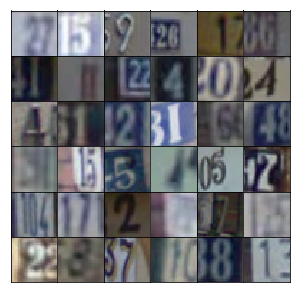

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [9]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [10]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [11]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [12]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        fully_conn = tf.layers.dense(z, 4*4*512)
        fully_conn = tf.reshape(fully_conn, (-1,4,4,512))
        fully_conn = tf.layers.batch_normalization(fully_conn, training=training)
        fully_conn = tf.maximum(alpha*fully_conn, fully_conn)
        
        conv_layer1 = tf.layers.conv2d_transpose(fully_conn, 256, 5, strides=2, padding='same')
        conv_layer1 = tf.layers.batch_normalization(conv_layer1, training=training)
        conv_layer1 = tf.maximum(alpha*conv_layer1, conv_layer1)
        
        conv_layer2 = tf.layers.conv2d_transpose(conv_layer1, 128, 5, strides=2, padding='same')
        conv_layer2 = tf.layers.batch_normalization(conv_layer2, training=training)
        conv_layer2 = tf.maximum(alpha*conv_layer2, conv_layer2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv_layer2, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [42]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv_layer1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha*conv_layer1, conv_layer1)
        
        conv_layer2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        conv_layer2 = tf.layers.batch_normalization(conv_layer2, training=True)
        relu2 = tf.maximum(alpha*conv_layer2, conv_layer2)
        
        conv_layer3 = tf.layers.conv2d(relu2, 256,5, strides=2, padding='same')
        conv_layer3 = tf.layers.batch_normalization(conv_layer3, training=True)
        relu3 = tf.maximum(alpha*conv_layer3, conv_layer3)
        
        #Flat
        flat = tf.reshape(relu3, (-1, 4*4*256))
        
        #fully_conn1 = tf.layers.dense(flat, (4*4*256))
        #fully_conn1 = tf.layers.batch_normalization(fully_conn1, training=True)
        #relu4 = tf.maximum(alpha*fully_conn1, fully_conn1)
        
        #logits = tf.layers.dense(relu4, 1)
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [43]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [44]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [45]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [46]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [47]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 24
alpha = 0.02
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/24... Discriminator Loss: 0.8690... Generator Loss: 0.8649
Epoch 1/24... Discriminator Loss: 0.2386... Generator Loss: 2.0588
Epoch 1/24... Discriminator Loss: 0.1413... Generator Loss: 2.5396
Epoch 1/24... Discriminator Loss: 0.0880... Generator Loss: 3.6182
Epoch 1/24... Discriminator Loss: 0.0884... Generator Loss: 3.1903
Epoch 1/24... Discriminator Loss: 0.1231... Generator Loss: 2.7449
Epoch 1/24... Discriminator Loss: 0.1251... Generator Loss: 2.4187
Epoch 1/24... Discriminator Loss: 0.1843... Generator Loss: 2.1039
Epoch 1/24... Discriminator Loss: 0.0722... Generator Loss: 3.4698
Epoch 1/24... Discriminator Loss: 0.1121... Generator Loss: 3.0407


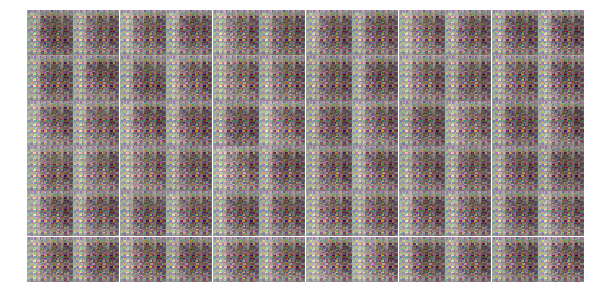

Epoch 1/24... Discriminator Loss: 0.0438... Generator Loss: 4.0343
Epoch 1/24... Discriminator Loss: 0.0667... Generator Loss: 3.4654
Epoch 1/24... Discriminator Loss: 0.0337... Generator Loss: 4.4728
Epoch 1/24... Discriminator Loss: 0.1350... Generator Loss: 3.2348
Epoch 1/24... Discriminator Loss: 1.3205... Generator Loss: 2.4911
Epoch 1/24... Discriminator Loss: 0.7023... Generator Loss: 2.4305
Epoch 1/24... Discriminator Loss: 0.6825... Generator Loss: 1.5307
Epoch 1/24... Discriminator Loss: 0.2906... Generator Loss: 2.2008
Epoch 1/24... Discriminator Loss: 0.5490... Generator Loss: 1.6253
Epoch 1/24... Discriminator Loss: 0.1395... Generator Loss: 3.3905


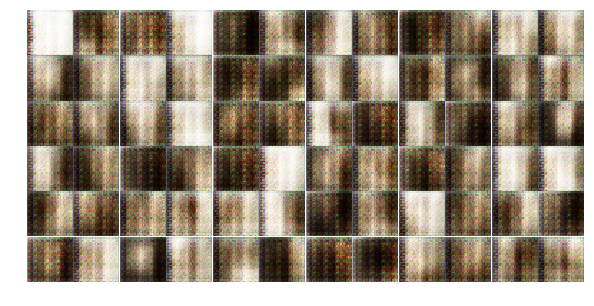

Epoch 1/24... Discriminator Loss: 1.4700... Generator Loss: 0.7486
Epoch 1/24... Discriminator Loss: 0.4899... Generator Loss: 1.7497
Epoch 1/24... Discriminator Loss: 0.6773... Generator Loss: 5.8601
Epoch 1/24... Discriminator Loss: 0.2204... Generator Loss: 2.1384
Epoch 1/24... Discriminator Loss: 0.1506... Generator Loss: 3.4981
Epoch 1/24... Discriminator Loss: 0.1213... Generator Loss: 3.0695
Epoch 1/24... Discriminator Loss: 0.1477... Generator Loss: 3.2452
Epoch 1/24... Discriminator Loss: 0.6646... Generator Loss: 2.4649
Epoch 1/24... Discriminator Loss: 0.7645... Generator Loss: 1.1662
Epoch 1/24... Discriminator Loss: 0.2233... Generator Loss: 2.5862


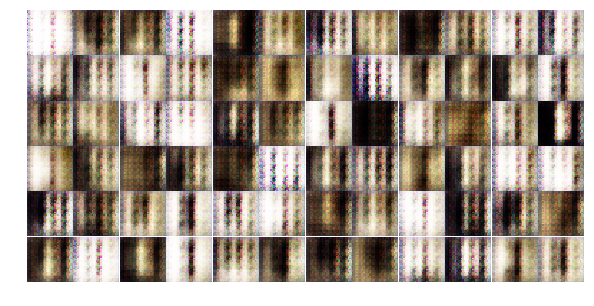

Epoch 1/24... Discriminator Loss: 0.7403... Generator Loss: 0.9802
Epoch 1/24... Discriminator Loss: 0.4459... Generator Loss: 1.3771
Epoch 1/24... Discriminator Loss: 0.6360... Generator Loss: 1.2619
Epoch 1/24... Discriminator Loss: 0.2519... Generator Loss: 4.1216
Epoch 1/24... Discriminator Loss: 0.3808... Generator Loss: 1.5371
Epoch 1/24... Discriminator Loss: 0.2797... Generator Loss: 2.9998
Epoch 1/24... Discriminator Loss: 0.6100... Generator Loss: 1.5542
Epoch 1/24... Discriminator Loss: 0.3304... Generator Loss: 2.6579
Epoch 1/24... Discriminator Loss: 0.4022... Generator Loss: 1.5054
Epoch 1/24... Discriminator Loss: 0.5606... Generator Loss: 2.3469


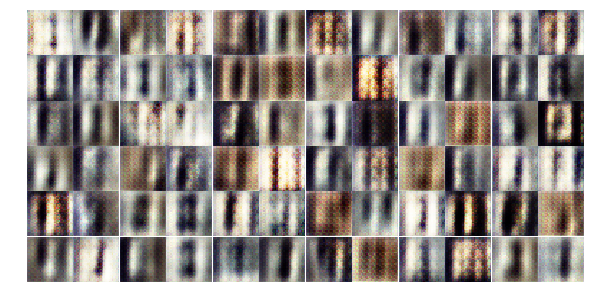

Epoch 1/24... Discriminator Loss: 0.1997... Generator Loss: 2.8070
Epoch 1/24... Discriminator Loss: 0.2794... Generator Loss: 2.4852
Epoch 1/24... Discriminator Loss: 0.3379... Generator Loss: 2.8042
Epoch 1/24... Discriminator Loss: 0.6171... Generator Loss: 1.0169
Epoch 1/24... Discriminator Loss: 0.1586... Generator Loss: 2.8515
Epoch 1/24... Discriminator Loss: 0.1696... Generator Loss: 3.5217
Epoch 1/24... Discriminator Loss: 0.5050... Generator Loss: 1.3103
Epoch 1/24... Discriminator Loss: 0.2580... Generator Loss: 2.2492
Epoch 1/24... Discriminator Loss: 0.6561... Generator Loss: 1.4536
Epoch 1/24... Discriminator Loss: 0.6276... Generator Loss: 1.2313


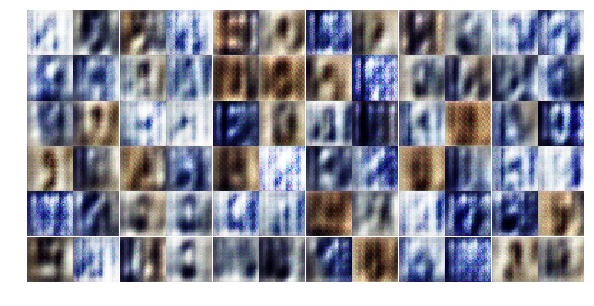

Epoch 1/24... Discriminator Loss: 0.5566... Generator Loss: 1.5420
Epoch 1/24... Discriminator Loss: 0.6285... Generator Loss: 1.2865
Epoch 1/24... Discriminator Loss: 0.4762... Generator Loss: 1.8173
Epoch 1/24... Discriminator Loss: 0.7901... Generator Loss: 0.8344
Epoch 1/24... Discriminator Loss: 0.1808... Generator Loss: 3.1054
Epoch 1/24... Discriminator Loss: 0.1713... Generator Loss: 3.1374
Epoch 1/24... Discriminator Loss: 0.2779... Generator Loss: 2.9630
Epoch 2/24... Discriminator Loss: 0.7831... Generator Loss: 1.2359
Epoch 2/24... Discriminator Loss: 0.9584... Generator Loss: 1.2022
Epoch 2/24... Discriminator Loss: 0.6952... Generator Loss: 1.7843


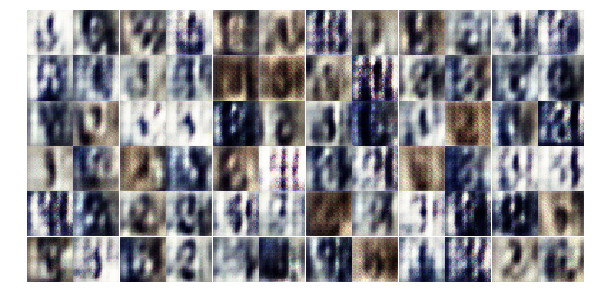

Epoch 2/24... Discriminator Loss: 0.6088... Generator Loss: 1.3490
Epoch 2/24... Discriminator Loss: 0.5951... Generator Loss: 2.9686
Epoch 2/24... Discriminator Loss: 0.8499... Generator Loss: 0.9373
Epoch 2/24... Discriminator Loss: 0.6679... Generator Loss: 1.7970
Epoch 2/24... Discriminator Loss: 0.4244... Generator Loss: 1.5860
Epoch 2/24... Discriminator Loss: 0.9038... Generator Loss: 2.0593
Epoch 2/24... Discriminator Loss: 0.4195... Generator Loss: 1.5989
Epoch 2/24... Discriminator Loss: 0.4284... Generator Loss: 2.8335
Epoch 2/24... Discriminator Loss: 0.6343... Generator Loss: 1.9577
Epoch 2/24... Discriminator Loss: 0.6163... Generator Loss: 1.1972


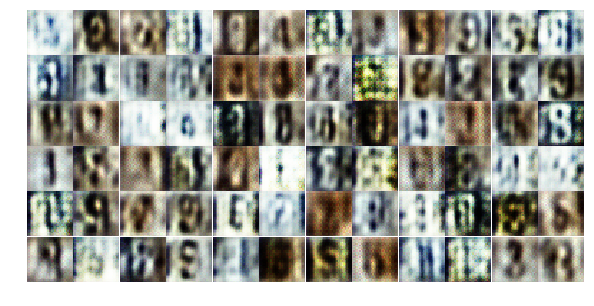

Epoch 2/24... Discriminator Loss: 0.3255... Generator Loss: 1.8989
Epoch 2/24... Discriminator Loss: 0.5105... Generator Loss: 2.1903
Epoch 2/24... Discriminator Loss: 1.0522... Generator Loss: 0.5745
Epoch 2/24... Discriminator Loss: 0.2740... Generator Loss: 2.2255
Epoch 2/24... Discriminator Loss: 0.8616... Generator Loss: 3.6133
Epoch 2/24... Discriminator Loss: 1.2060... Generator Loss: 1.3428
Epoch 2/24... Discriminator Loss: 0.9943... Generator Loss: 0.8938
Epoch 2/24... Discriminator Loss: 0.8395... Generator Loss: 0.8030
Epoch 2/24... Discriminator Loss: 0.5688... Generator Loss: 1.3528
Epoch 2/24... Discriminator Loss: 0.6931... Generator Loss: 0.9336


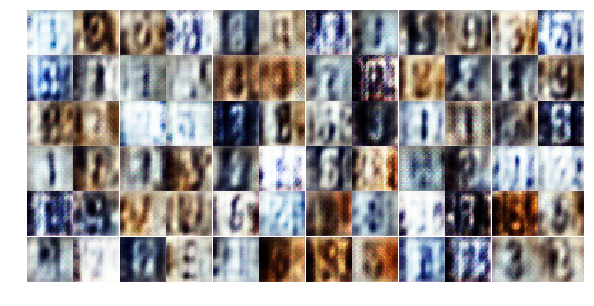

Epoch 2/24... Discriminator Loss: 0.6614... Generator Loss: 1.2044
Epoch 2/24... Discriminator Loss: 1.9978... Generator Loss: 4.0838
Epoch 2/24... Discriminator Loss: 2.2383... Generator Loss: 0.2165
Epoch 2/24... Discriminator Loss: 0.6127... Generator Loss: 1.7566
Epoch 2/24... Discriminator Loss: 0.4102... Generator Loss: 1.9778
Epoch 2/24... Discriminator Loss: 0.6110... Generator Loss: 1.4395
Epoch 2/24... Discriminator Loss: 0.5581... Generator Loss: 1.3222
Epoch 2/24... Discriminator Loss: 1.4425... Generator Loss: 0.4011
Epoch 2/24... Discriminator Loss: 0.7507... Generator Loss: 0.9744
Epoch 2/24... Discriminator Loss: 0.4570... Generator Loss: 1.6489


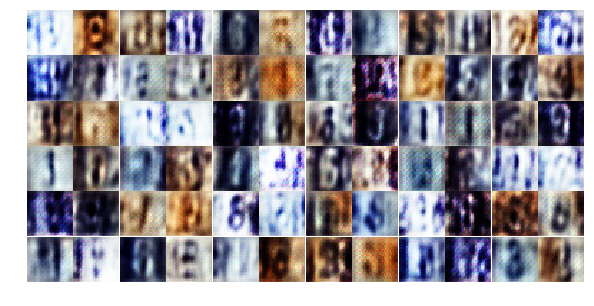

Epoch 2/24... Discriminator Loss: 1.4348... Generator Loss: 0.3343
Epoch 2/24... Discriminator Loss: 1.4891... Generator Loss: 2.6525
Epoch 2/24... Discriminator Loss: 1.9115... Generator Loss: 5.6218
Epoch 2/24... Discriminator Loss: 1.1172... Generator Loss: 0.6175
Epoch 2/24... Discriminator Loss: 0.3448... Generator Loss: 2.6363
Epoch 2/24... Discriminator Loss: 1.0866... Generator Loss: 0.6251
Epoch 2/24... Discriminator Loss: 0.2072... Generator Loss: 3.8136
Epoch 2/24... Discriminator Loss: 0.4455... Generator Loss: 1.5887
Epoch 2/24... Discriminator Loss: 1.6866... Generator Loss: 0.2719
Epoch 2/24... Discriminator Loss: 0.3640... Generator Loss: 1.7098


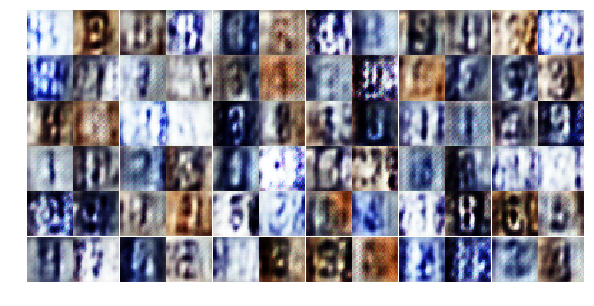

Epoch 2/24... Discriminator Loss: 0.3325... Generator Loss: 1.9268
Epoch 2/24... Discriminator Loss: 0.7334... Generator Loss: 1.1025
Epoch 2/24... Discriminator Loss: 0.8193... Generator Loss: 2.3640
Epoch 2/24... Discriminator Loss: 0.3588... Generator Loss: 3.0758
Epoch 2/24... Discriminator Loss: 1.4512... Generator Loss: 0.3996
Epoch 2/24... Discriminator Loss: 0.7808... Generator Loss: 0.8749
Epoch 2/24... Discriminator Loss: 0.1725... Generator Loss: 3.1204
Epoch 2/24... Discriminator Loss: 0.9589... Generator Loss: 3.4458
Epoch 2/24... Discriminator Loss: 0.2489... Generator Loss: 4.2518
Epoch 2/24... Discriminator Loss: 0.7326... Generator Loss: 1.5405


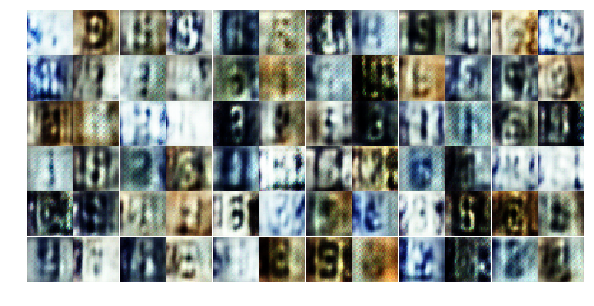

Epoch 2/24... Discriminator Loss: 0.3678... Generator Loss: 1.7737
Epoch 2/24... Discriminator Loss: 0.1772... Generator Loss: 3.2829
Epoch 2/24... Discriminator Loss: 0.8159... Generator Loss: 0.7912
Epoch 2/24... Discriminator Loss: 0.2306... Generator Loss: 2.5863
Epoch 3/24... Discriminator Loss: 0.8950... Generator Loss: 3.3245
Epoch 3/24... Discriminator Loss: 1.1840... Generator Loss: 0.5987
Epoch 3/24... Discriminator Loss: 1.2687... Generator Loss: 3.1025
Epoch 3/24... Discriminator Loss: 0.1481... Generator Loss: 3.1105
Epoch 3/24... Discriminator Loss: 0.4444... Generator Loss: 1.5990
Epoch 3/24... Discriminator Loss: 0.5228... Generator Loss: 1.1431


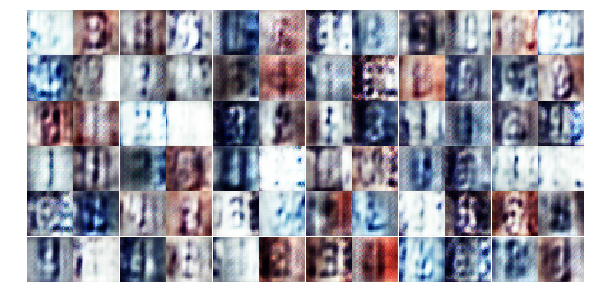

Epoch 3/24... Discriminator Loss: 0.3443... Generator Loss: 1.8175
Epoch 3/24... Discriminator Loss: 0.1505... Generator Loss: 4.0652
Epoch 3/24... Discriminator Loss: 0.6101... Generator Loss: 3.6596
Epoch 3/24... Discriminator Loss: 0.7639... Generator Loss: 2.2813
Epoch 3/24... Discriminator Loss: 0.4971... Generator Loss: 1.4979
Epoch 3/24... Discriminator Loss: 0.9790... Generator Loss: 4.1528
Epoch 3/24... Discriminator Loss: 0.5724... Generator Loss: 3.7785
Epoch 3/24... Discriminator Loss: 0.2222... Generator Loss: 2.5423
Epoch 3/24... Discriminator Loss: 0.4014... Generator Loss: 1.4717
Epoch 3/24... Discriminator Loss: 1.3740... Generator Loss: 6.0134


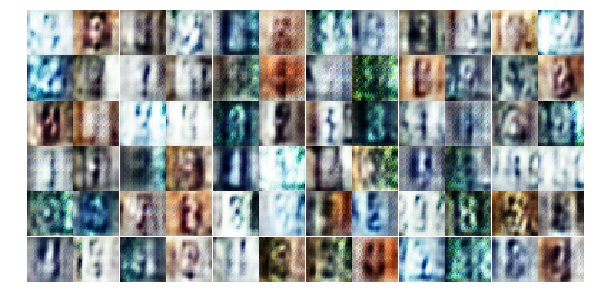

Epoch 3/24... Discriminator Loss: 0.4111... Generator Loss: 2.8496
Epoch 3/24... Discriminator Loss: 0.3506... Generator Loss: 1.7669
Epoch 3/24... Discriminator Loss: 0.2826... Generator Loss: 2.9959
Epoch 3/24... Discriminator Loss: 0.5235... Generator Loss: 1.2334
Epoch 3/24... Discriminator Loss: 0.8917... Generator Loss: 1.9443
Epoch 3/24... Discriminator Loss: 0.3361... Generator Loss: 2.5827
Epoch 3/24... Discriminator Loss: 0.6024... Generator Loss: 2.1519
Epoch 3/24... Discriminator Loss: 0.2570... Generator Loss: 2.3540
Epoch 3/24... Discriminator Loss: 0.5238... Generator Loss: 1.6398
Epoch 3/24... Discriminator Loss: 1.5541... Generator Loss: 3.8446


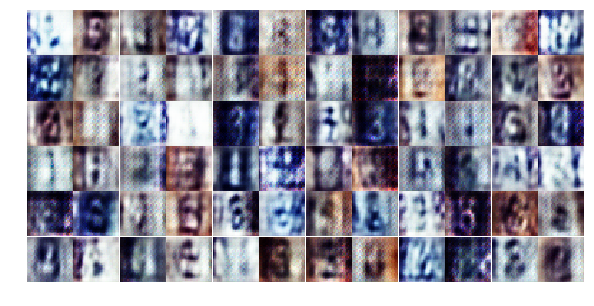

Epoch 3/24... Discriminator Loss: 0.5469... Generator Loss: 2.5308
Epoch 3/24... Discriminator Loss: 0.5112... Generator Loss: 1.7663
Epoch 3/24... Discriminator Loss: 0.2534... Generator Loss: 3.0677
Epoch 3/24... Discriminator Loss: 1.8690... Generator Loss: 0.2801
Epoch 3/24... Discriminator Loss: 0.7846... Generator Loss: 1.5284
Epoch 3/24... Discriminator Loss: 0.3258... Generator Loss: 2.8054
Epoch 3/24... Discriminator Loss: 0.2619... Generator Loss: 2.4841
Epoch 3/24... Discriminator Loss: 1.1961... Generator Loss: 3.6169
Epoch 3/24... Discriminator Loss: 1.0237... Generator Loss: 0.6823
Epoch 3/24... Discriminator Loss: 0.8970... Generator Loss: 0.6985


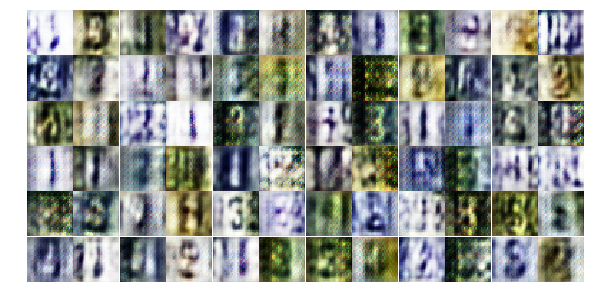

Epoch 3/24... Discriminator Loss: 1.4787... Generator Loss: 4.5414
Epoch 3/24... Discriminator Loss: 0.8148... Generator Loss: 1.4144
Epoch 3/24... Discriminator Loss: 0.3370... Generator Loss: 2.2206
Epoch 3/24... Discriminator Loss: 0.5161... Generator Loss: 1.7198
Epoch 3/24... Discriminator Loss: 0.6072... Generator Loss: 3.0181
Epoch 3/24... Discriminator Loss: 1.0553... Generator Loss: 2.6737
Epoch 3/24... Discriminator Loss: 0.3252... Generator Loss: 1.9486
Epoch 3/24... Discriminator Loss: 0.6609... Generator Loss: 1.1679
Epoch 3/24... Discriminator Loss: 0.8889... Generator Loss: 0.8113
Epoch 3/24... Discriminator Loss: 0.2900... Generator Loss: 2.0952


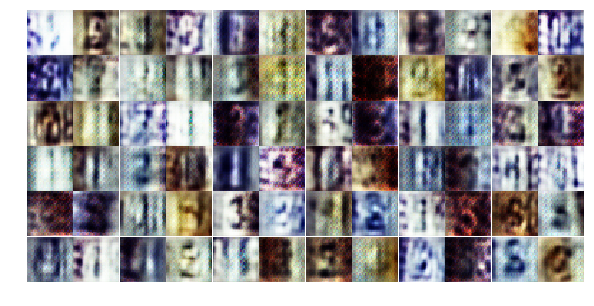

Epoch 3/24... Discriminator Loss: 0.5840... Generator Loss: 3.4897
Epoch 3/24... Discriminator Loss: 1.0144... Generator Loss: 0.6657
Epoch 3/24... Discriminator Loss: 0.2401... Generator Loss: 2.7739
Epoch 3/24... Discriminator Loss: 0.5240... Generator Loss: 1.3141
Epoch 3/24... Discriminator Loss: 0.8150... Generator Loss: 1.0276
Epoch 3/24... Discriminator Loss: 0.4611... Generator Loss: 1.7895
Epoch 3/24... Discriminator Loss: 0.6111... Generator Loss: 1.3125
Epoch 3/24... Discriminator Loss: 0.1909... Generator Loss: 2.0916
Epoch 3/24... Discriminator Loss: 0.1742... Generator Loss: 2.2827
Epoch 3/24... Discriminator Loss: 0.5084... Generator Loss: 2.0948


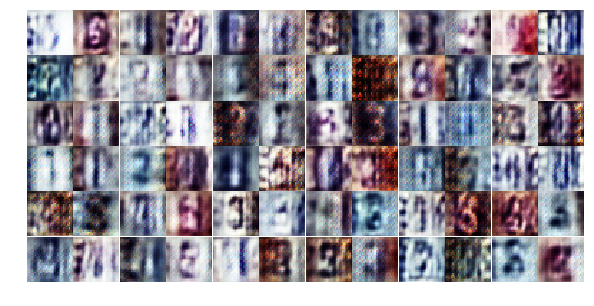

Epoch 3/24... Discriminator Loss: 1.0268... Generator Loss: 0.7052
Epoch 4/24... Discriminator Loss: 0.1764... Generator Loss: 3.3332
Epoch 4/24... Discriminator Loss: 0.6892... Generator Loss: 1.2857
Epoch 4/24... Discriminator Loss: 0.5628... Generator Loss: 1.2599
Epoch 4/24... Discriminator Loss: 0.3259... Generator Loss: 5.9207
Epoch 4/24... Discriminator Loss: 0.1288... Generator Loss: 4.0671
Epoch 4/24... Discriminator Loss: 0.3447... Generator Loss: 1.8616
Epoch 4/24... Discriminator Loss: 0.5961... Generator Loss: 2.6103
Epoch 4/24... Discriminator Loss: 1.6514... Generator Loss: 2.7187
Epoch 4/24... Discriminator Loss: 0.8803... Generator Loss: 0.8043


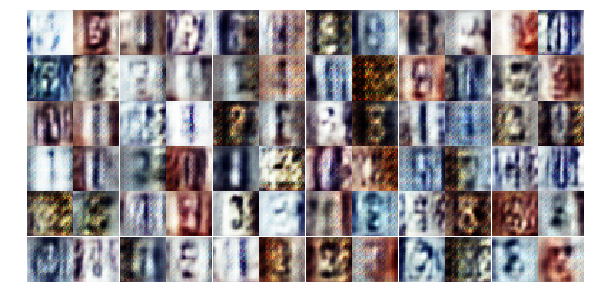

Epoch 4/24... Discriminator Loss: 0.2016... Generator Loss: 2.5618
Epoch 4/24... Discriminator Loss: 0.2133... Generator Loss: 2.3911
Epoch 4/24... Discriminator Loss: 0.5124... Generator Loss: 1.5099
Epoch 4/24... Discriminator Loss: 0.4083... Generator Loss: 1.8293
Epoch 4/24... Discriminator Loss: 0.3340... Generator Loss: 2.0636
Epoch 4/24... Discriminator Loss: 1.2739... Generator Loss: 0.4911
Epoch 4/24... Discriminator Loss: 0.1864... Generator Loss: 2.4114
Epoch 4/24... Discriminator Loss: 0.4510... Generator Loss: 1.5984
Epoch 4/24... Discriminator Loss: 0.9940... Generator Loss: 0.9352
Epoch 4/24... Discriminator Loss: 0.2382... Generator Loss: 2.8458


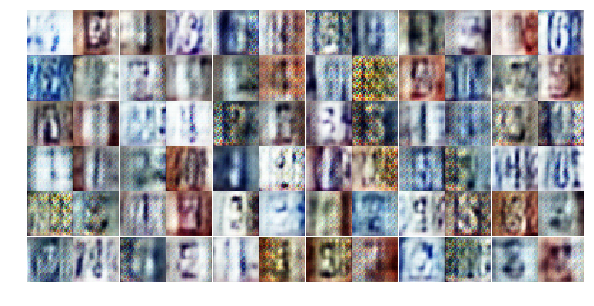

Epoch 4/24... Discriminator Loss: 1.1590... Generator Loss: 1.8643
Epoch 4/24... Discriminator Loss: 0.4382... Generator Loss: 1.8645
Epoch 4/24... Discriminator Loss: 0.7644... Generator Loss: 2.2160
Epoch 4/24... Discriminator Loss: 1.0496... Generator Loss: 0.5747
Epoch 4/24... Discriminator Loss: 0.3296... Generator Loss: 1.9254
Epoch 4/24... Discriminator Loss: 0.2181... Generator Loss: 2.2723
Epoch 4/24... Discriminator Loss: 0.6599... Generator Loss: 1.0823
Epoch 4/24... Discriminator Loss: 1.2602... Generator Loss: 0.4563
Epoch 4/24... Discriminator Loss: 0.2412... Generator Loss: 4.6841
Epoch 4/24... Discriminator Loss: 0.8737... Generator Loss: 1.1334


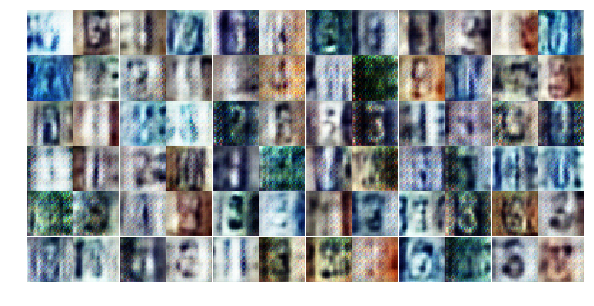

Epoch 4/24... Discriminator Loss: 0.5401... Generator Loss: 1.3940
Epoch 4/24... Discriminator Loss: 0.5347... Generator Loss: 1.2893
Epoch 4/24... Discriminator Loss: 0.8626... Generator Loss: 0.8571
Epoch 4/24... Discriminator Loss: 0.3299... Generator Loss: 2.3567
Epoch 4/24... Discriminator Loss: 0.5024... Generator Loss: 2.5184
Epoch 4/24... Discriminator Loss: 1.0590... Generator Loss: 0.6135
Epoch 4/24... Discriminator Loss: 0.3095... Generator Loss: 2.1182
Epoch 4/24... Discriminator Loss: 0.4195... Generator Loss: 1.4198
Epoch 4/24... Discriminator Loss: 1.3473... Generator Loss: 0.4047
Epoch 4/24... Discriminator Loss: 0.4327... Generator Loss: 2.4436


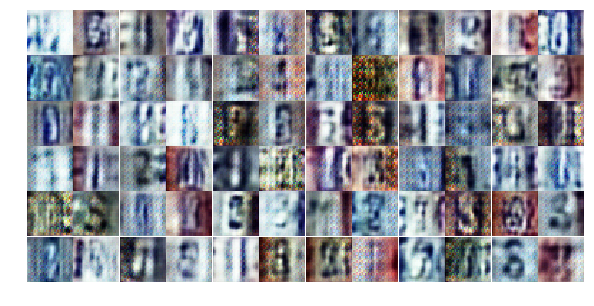

Epoch 4/24... Discriminator Loss: 0.6360... Generator Loss: 2.5107
Epoch 4/24... Discriminator Loss: 0.3543... Generator Loss: 2.1329
Epoch 4/24... Discriminator Loss: 0.5257... Generator Loss: 1.7882
Epoch 4/24... Discriminator Loss: 0.4462... Generator Loss: 1.5635
Epoch 4/24... Discriminator Loss: 0.5352... Generator Loss: 1.4543
Epoch 4/24... Discriminator Loss: 0.5774... Generator Loss: 1.1482
Epoch 4/24... Discriminator Loss: 0.4144... Generator Loss: 1.5242
Epoch 4/24... Discriminator Loss: 0.3234... Generator Loss: 2.1063
Epoch 4/24... Discriminator Loss: 0.6529... Generator Loss: 1.3070
Epoch 4/24... Discriminator Loss: 0.6889... Generator Loss: 2.1288


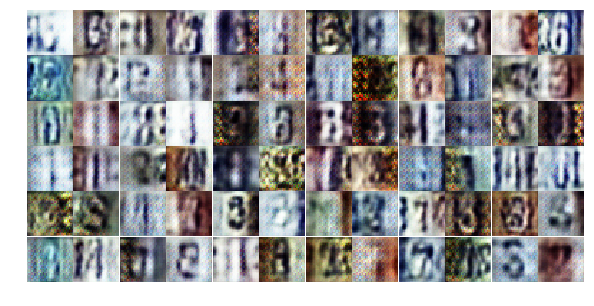

Epoch 4/24... Discriminator Loss: 0.6203... Generator Loss: 1.1200
Epoch 4/24... Discriminator Loss: 0.4486... Generator Loss: 1.3456
Epoch 4/24... Discriminator Loss: 0.5768... Generator Loss: 1.7629
Epoch 4/24... Discriminator Loss: 0.2418... Generator Loss: 2.3138
Epoch 4/24... Discriminator Loss: 0.7973... Generator Loss: 1.2554
Epoch 4/24... Discriminator Loss: 0.9218... Generator Loss: 1.9483
Epoch 4/24... Discriminator Loss: 0.4401... Generator Loss: 1.7033
Epoch 4/24... Discriminator Loss: 0.6211... Generator Loss: 1.4652
Epoch 4/24... Discriminator Loss: 0.3623... Generator Loss: 1.7189
Epoch 5/24... Discriminator Loss: 0.3810... Generator Loss: 1.6367


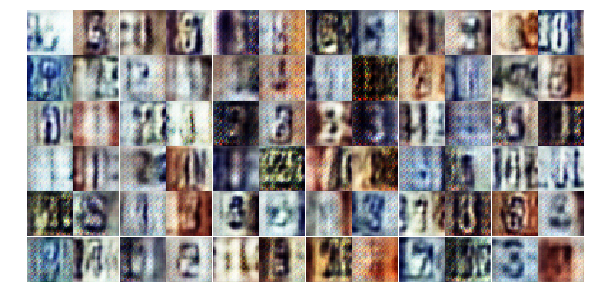

Epoch 5/24... Discriminator Loss: 0.7255... Generator Loss: 1.9929
Epoch 5/24... Discriminator Loss: 1.0450... Generator Loss: 0.6030
Epoch 5/24... Discriminator Loss: 0.8706... Generator Loss: 3.1756
Epoch 5/24... Discriminator Loss: 0.9006... Generator Loss: 0.7316
Epoch 5/24... Discriminator Loss: 0.4200... Generator Loss: 1.3544
Epoch 5/24... Discriminator Loss: 0.4111... Generator Loss: 1.4845
Epoch 5/24... Discriminator Loss: 0.8650... Generator Loss: 0.7450
Epoch 5/24... Discriminator Loss: 0.2335... Generator Loss: 2.0926
Epoch 5/24... Discriminator Loss: 0.9649... Generator Loss: 0.6356
Epoch 5/24... Discriminator Loss: 0.6974... Generator Loss: 1.3573


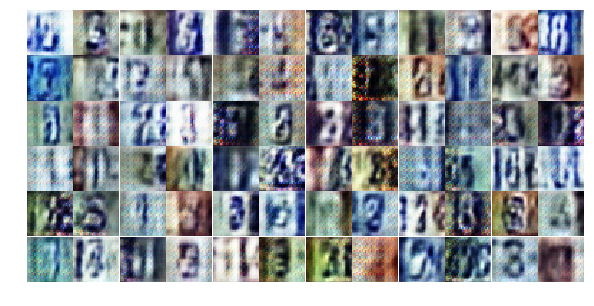

Epoch 5/24... Discriminator Loss: 0.6993... Generator Loss: 0.8614
Epoch 5/24... Discriminator Loss: 0.7037... Generator Loss: 2.2717
Epoch 5/24... Discriminator Loss: 0.1727... Generator Loss: 2.5319
Epoch 5/24... Discriminator Loss: 1.1662... Generator Loss: 0.7486
Epoch 5/24... Discriminator Loss: 0.4473... Generator Loss: 1.5833
Epoch 5/24... Discriminator Loss: 0.9626... Generator Loss: 0.6780
Epoch 5/24... Discriminator Loss: 0.3229... Generator Loss: 1.9768
Epoch 5/24... Discriminator Loss: 0.5686... Generator Loss: 2.8256
Epoch 5/24... Discriminator Loss: 0.6027... Generator Loss: 1.6194
Epoch 5/24... Discriminator Loss: 0.3292... Generator Loss: 1.7675


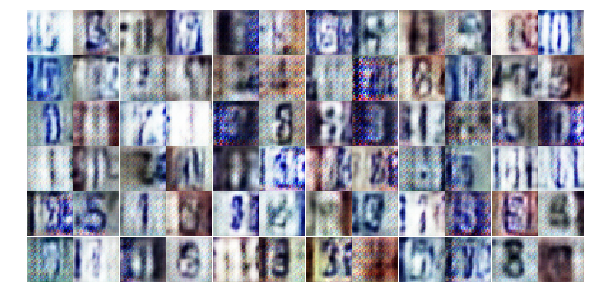

Epoch 5/24... Discriminator Loss: 0.2000... Generator Loss: 2.8326
Epoch 5/24... Discriminator Loss: 0.6328... Generator Loss: 1.5725
Epoch 5/24... Discriminator Loss: 0.5866... Generator Loss: 2.6210
Epoch 5/24... Discriminator Loss: 0.7357... Generator Loss: 1.1618
Epoch 5/24... Discriminator Loss: 2.0574... Generator Loss: 0.1891
Epoch 5/24... Discriminator Loss: 0.4388... Generator Loss: 1.4580
Epoch 5/24... Discriminator Loss: 1.0968... Generator Loss: 0.5670
Epoch 5/24... Discriminator Loss: 0.2418... Generator Loss: 2.3305
Epoch 5/24... Discriminator Loss: 0.4917... Generator Loss: 1.3653
Epoch 5/24... Discriminator Loss: 0.6113... Generator Loss: 1.0836


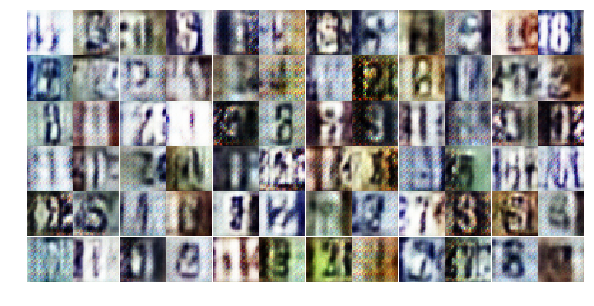

Epoch 5/24... Discriminator Loss: 1.2614... Generator Loss: 2.3120
Epoch 5/24... Discriminator Loss: 0.2140... Generator Loss: 3.0520
Epoch 5/24... Discriminator Loss: 0.3895... Generator Loss: 2.5560
Epoch 5/24... Discriminator Loss: 0.5438... Generator Loss: 1.1288
Epoch 5/24... Discriminator Loss: 0.3644... Generator Loss: 3.2325
Epoch 5/24... Discriminator Loss: 0.9000... Generator Loss: 0.8433
Epoch 5/24... Discriminator Loss: 0.4754... Generator Loss: 1.7803
Epoch 5/24... Discriminator Loss: 0.4493... Generator Loss: 1.4937
Epoch 5/24... Discriminator Loss: 0.8218... Generator Loss: 0.7584
Epoch 5/24... Discriminator Loss: 0.8745... Generator Loss: 0.7652


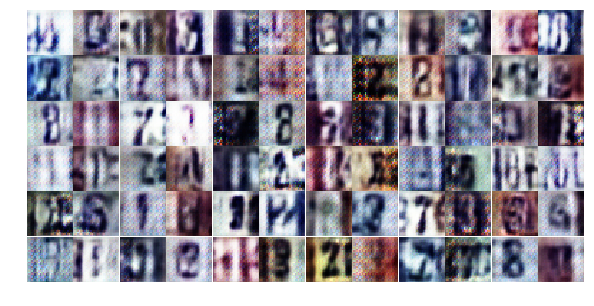

Epoch 5/24... Discriminator Loss: 0.5963... Generator Loss: 1.4951
Epoch 5/24... Discriminator Loss: 0.5756... Generator Loss: 1.1492
Epoch 5/24... Discriminator Loss: 0.3037... Generator Loss: 1.7367
Epoch 5/24... Discriminator Loss: 0.3761... Generator Loss: 2.2295
Epoch 5/24... Discriminator Loss: 0.3727... Generator Loss: 1.9919
Epoch 5/24... Discriminator Loss: 0.5601... Generator Loss: 1.1573
Epoch 5/24... Discriminator Loss: 0.7831... Generator Loss: 0.8164
Epoch 5/24... Discriminator Loss: 1.2089... Generator Loss: 0.5052
Epoch 5/24... Discriminator Loss: 1.0871... Generator Loss: 0.5797
Epoch 5/24... Discriminator Loss: 0.8107... Generator Loss: 1.0889


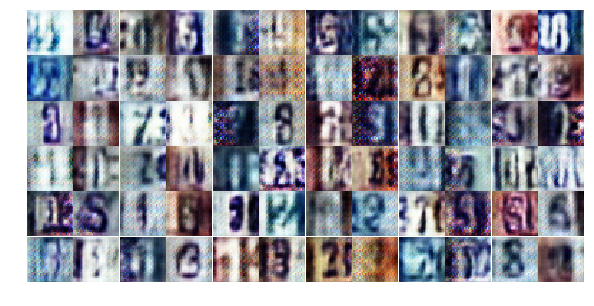

Epoch 5/24... Discriminator Loss: 0.5453... Generator Loss: 1.1651
Epoch 5/24... Discriminator Loss: 0.6097... Generator Loss: 1.1159
Epoch 5/24... Discriminator Loss: 1.5447... Generator Loss: 0.3225
Epoch 5/24... Discriminator Loss: 0.7366... Generator Loss: 1.2055
Epoch 5/24... Discriminator Loss: 1.0027... Generator Loss: 0.9580
Epoch 5/24... Discriminator Loss: 0.9847... Generator Loss: 0.9097
Epoch 6/24... Discriminator Loss: 0.7833... Generator Loss: 0.8933
Epoch 6/24... Discriminator Loss: 0.2372... Generator Loss: 2.3190
Epoch 6/24... Discriminator Loss: 0.5533... Generator Loss: 1.6881
Epoch 6/24... Discriminator Loss: 0.9445... Generator Loss: 0.7349


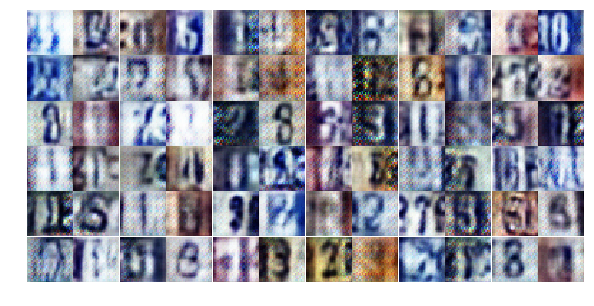

Epoch 6/24... Discriminator Loss: 0.4719... Generator Loss: 1.4331
Epoch 6/24... Discriminator Loss: 0.6457... Generator Loss: 0.9462
Epoch 6/24... Discriminator Loss: 0.9335... Generator Loss: 0.9210
Epoch 6/24... Discriminator Loss: 0.8976... Generator Loss: 0.8068
Epoch 6/24... Discriminator Loss: 0.8410... Generator Loss: 0.9317
Epoch 6/24... Discriminator Loss: 0.4798... Generator Loss: 1.4625
Epoch 6/24... Discriminator Loss: 0.8484... Generator Loss: 0.9206
Epoch 6/24... Discriminator Loss: 0.7160... Generator Loss: 0.9154
Epoch 6/24... Discriminator Loss: 0.6075... Generator Loss: 1.0792
Epoch 6/24... Discriminator Loss: 0.6036... Generator Loss: 1.4201


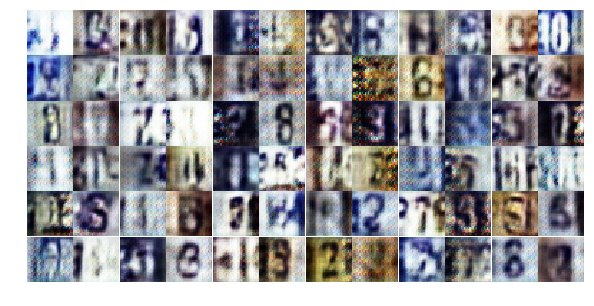

Epoch 6/24... Discriminator Loss: 1.1702... Generator Loss: 0.5218
Epoch 6/24... Discriminator Loss: 0.7877... Generator Loss: 0.9034
Epoch 6/24... Discriminator Loss: 0.9441... Generator Loss: 0.6495
Epoch 6/24... Discriminator Loss: 1.8081... Generator Loss: 0.2370
Epoch 6/24... Discriminator Loss: 0.5385... Generator Loss: 1.6304
Epoch 6/24... Discriminator Loss: 0.4861... Generator Loss: 1.7218
Epoch 6/24... Discriminator Loss: 0.6447... Generator Loss: 1.2488
Epoch 6/24... Discriminator Loss: 0.6003... Generator Loss: 2.3107
Epoch 6/24... Discriminator Loss: 0.7697... Generator Loss: 0.9448
Epoch 6/24... Discriminator Loss: 0.7535... Generator Loss: 0.9845


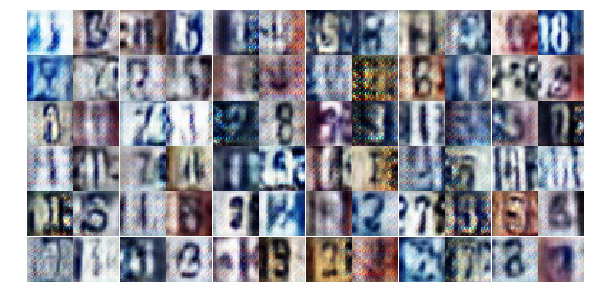

Epoch 6/24... Discriminator Loss: 0.7259... Generator Loss: 0.8794
Epoch 6/24... Discriminator Loss: 0.6051... Generator Loss: 1.1843
Epoch 6/24... Discriminator Loss: 0.7931... Generator Loss: 1.0981
Epoch 6/24... Discriminator Loss: 0.8811... Generator Loss: 0.7810
Epoch 6/24... Discriminator Loss: 0.7424... Generator Loss: 2.4006
Epoch 6/24... Discriminator Loss: 0.6214... Generator Loss: 1.3826
Epoch 6/24... Discriminator Loss: 0.4387... Generator Loss: 1.4815
Epoch 6/24... Discriminator Loss: 0.3375... Generator Loss: 1.9079
Epoch 6/24... Discriminator Loss: 0.5241... Generator Loss: 1.1677
Epoch 6/24... Discriminator Loss: 0.3277... Generator Loss: 2.0997


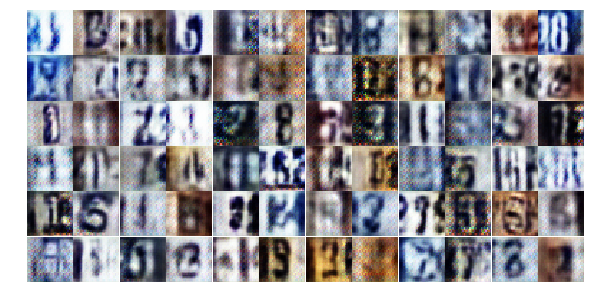

Epoch 6/24... Discriminator Loss: 1.1867... Generator Loss: 0.5133
Epoch 6/24... Discriminator Loss: 0.6933... Generator Loss: 2.1737
Epoch 6/24... Discriminator Loss: 0.6198... Generator Loss: 1.7081
Epoch 6/24... Discriminator Loss: 0.9128... Generator Loss: 0.7208
Epoch 6/24... Discriminator Loss: 1.3944... Generator Loss: 0.4726
Epoch 6/24... Discriminator Loss: 0.6523... Generator Loss: 1.0101
Epoch 6/24... Discriminator Loss: 0.5995... Generator Loss: 1.3852
Epoch 6/24... Discriminator Loss: 0.4315... Generator Loss: 1.4567
Epoch 6/24... Discriminator Loss: 0.6898... Generator Loss: 0.9869
Epoch 6/24... Discriminator Loss: 0.3451... Generator Loss: 1.7943


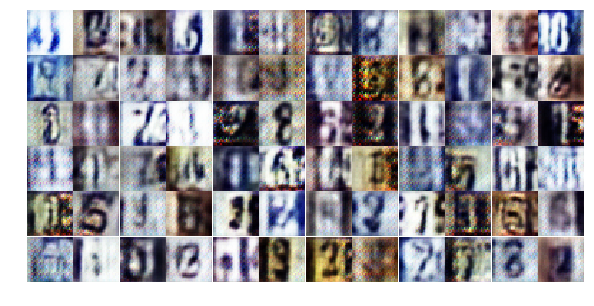

Epoch 6/24... Discriminator Loss: 0.6559... Generator Loss: 1.0394
Epoch 6/24... Discriminator Loss: 0.3624... Generator Loss: 2.2979
Epoch 6/24... Discriminator Loss: 0.4269... Generator Loss: 1.4591
Epoch 6/24... Discriminator Loss: 1.5617... Generator Loss: 0.3934
Epoch 6/24... Discriminator Loss: 0.6764... Generator Loss: 1.1069
Epoch 6/24... Discriminator Loss: 0.3128... Generator Loss: 1.8199
Epoch 6/24... Discriminator Loss: 1.0224... Generator Loss: 0.6643
Epoch 6/24... Discriminator Loss: 0.6408... Generator Loss: 1.0139
Epoch 6/24... Discriminator Loss: 1.2055... Generator Loss: 0.5419
Epoch 6/24... Discriminator Loss: 1.8819... Generator Loss: 0.2666


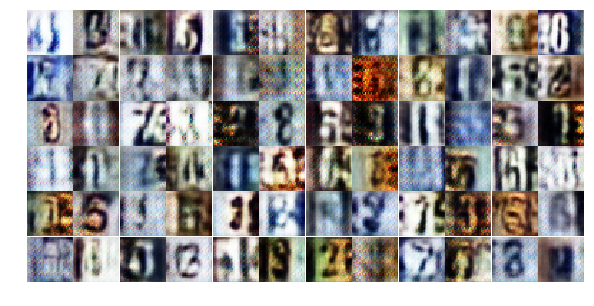

Epoch 6/24... Discriminator Loss: 0.5341... Generator Loss: 1.2666
Epoch 6/24... Discriminator Loss: 0.6383... Generator Loss: 1.0321
Epoch 6/24... Discriminator Loss: 0.3979... Generator Loss: 1.6165
Epoch 7/24... Discriminator Loss: 1.2221... Generator Loss: 0.5265
Epoch 7/24... Discriminator Loss: 0.4716... Generator Loss: 1.5125
Epoch 7/24... Discriminator Loss: 1.0380... Generator Loss: 0.8273
Epoch 7/24... Discriminator Loss: 0.6261... Generator Loss: 1.2531
Epoch 7/24... Discriminator Loss: 0.5933... Generator Loss: 1.3738
Epoch 7/24... Discriminator Loss: 0.6286... Generator Loss: 1.5223
Epoch 7/24... Discriminator Loss: 0.5276... Generator Loss: 1.8773


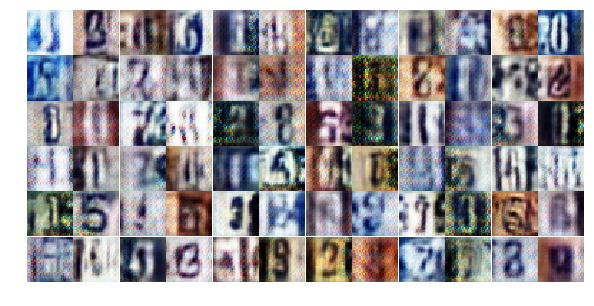

Epoch 7/24... Discriminator Loss: 0.6952... Generator Loss: 1.3124
Epoch 7/24... Discriminator Loss: 0.3281... Generator Loss: 1.9076
Epoch 7/24... Discriminator Loss: 0.7472... Generator Loss: 0.9320
Epoch 7/24... Discriminator Loss: 0.5058... Generator Loss: 1.4139
Epoch 7/24... Discriminator Loss: 0.3085... Generator Loss: 1.7272
Epoch 7/24... Discriminator Loss: 0.5064... Generator Loss: 1.8826
Epoch 7/24... Discriminator Loss: 0.7016... Generator Loss: 1.6867
Epoch 7/24... Discriminator Loss: 1.0472... Generator Loss: 1.1838
Epoch 7/24... Discriminator Loss: 0.9581... Generator Loss: 3.0769
Epoch 7/24... Discriminator Loss: 0.5230... Generator Loss: 2.0516


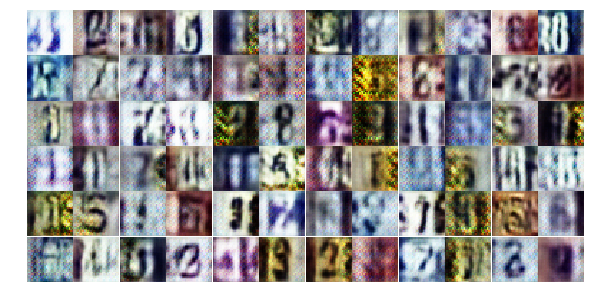

Epoch 7/24... Discriminator Loss: 0.5912... Generator Loss: 1.2976
Epoch 7/24... Discriminator Loss: 0.3814... Generator Loss: 2.4865
Epoch 7/24... Discriminator Loss: 0.7218... Generator Loss: 1.2809
Epoch 7/24... Discriminator Loss: 0.7360... Generator Loss: 1.0736
Epoch 7/24... Discriminator Loss: 0.3986... Generator Loss: 1.4092
Epoch 7/24... Discriminator Loss: 0.4826... Generator Loss: 2.8803
Epoch 7/24... Discriminator Loss: 0.9044... Generator Loss: 0.7166
Epoch 7/24... Discriminator Loss: 1.7660... Generator Loss: 0.2492
Epoch 7/24... Discriminator Loss: 0.4321... Generator Loss: 1.4646
Epoch 7/24... Discriminator Loss: 1.5078... Generator Loss: 2.6536


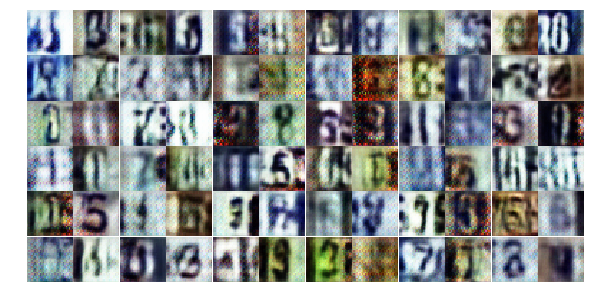

Epoch 7/24... Discriminator Loss: 0.5813... Generator Loss: 1.3091
Epoch 7/24... Discriminator Loss: 0.7995... Generator Loss: 0.7817
Epoch 7/24... Discriminator Loss: 0.3178... Generator Loss: 2.0574
Epoch 7/24... Discriminator Loss: 0.4271... Generator Loss: 1.4088
Epoch 7/24... Discriminator Loss: 0.6750... Generator Loss: 0.9472
Epoch 7/24... Discriminator Loss: 0.8612... Generator Loss: 0.7900
Epoch 7/24... Discriminator Loss: 1.0729... Generator Loss: 0.5891
Epoch 7/24... Discriminator Loss: 0.8518... Generator Loss: 0.7638
Epoch 7/24... Discriminator Loss: 1.1349... Generator Loss: 2.1888
Epoch 7/24... Discriminator Loss: 0.5984... Generator Loss: 2.1846


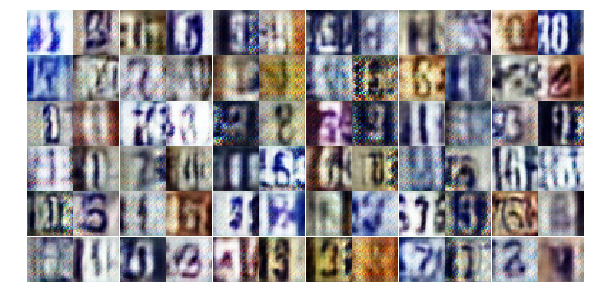

Epoch 7/24... Discriminator Loss: 1.0807... Generator Loss: 0.6134
Epoch 7/24... Discriminator Loss: 0.5015... Generator Loss: 1.3376
Epoch 7/24... Discriminator Loss: 0.2407... Generator Loss: 1.9656
Epoch 7/24... Discriminator Loss: 0.4626... Generator Loss: 1.6166
Epoch 7/24... Discriminator Loss: 0.7610... Generator Loss: 1.1075
Epoch 7/24... Discriminator Loss: 0.4127... Generator Loss: 1.9908
Epoch 7/24... Discriminator Loss: 0.6473... Generator Loss: 1.5544
Epoch 7/24... Discriminator Loss: 0.9112... Generator Loss: 1.1380
Epoch 7/24... Discriminator Loss: 0.3897... Generator Loss: 1.7475
Epoch 7/24... Discriminator Loss: 0.9771... Generator Loss: 0.7200


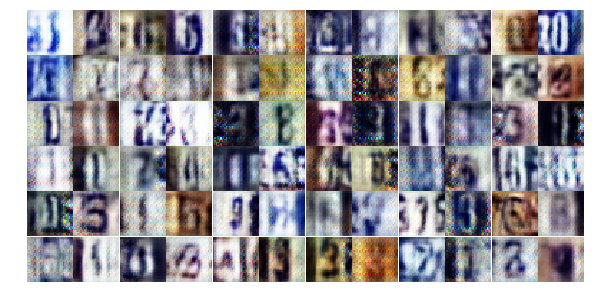

Epoch 7/24... Discriminator Loss: 0.7383... Generator Loss: 2.1206
Epoch 7/24... Discriminator Loss: 0.6767... Generator Loss: 1.0616
Epoch 7/24... Discriminator Loss: 0.7661... Generator Loss: 0.8372
Epoch 7/24... Discriminator Loss: 0.7065... Generator Loss: 0.9262
Epoch 7/24... Discriminator Loss: 0.6740... Generator Loss: 1.1368
Epoch 7/24... Discriminator Loss: 0.2561... Generator Loss: 2.0274
Epoch 7/24... Discriminator Loss: 0.6064... Generator Loss: 1.1208
Epoch 7/24... Discriminator Loss: 1.6953... Generator Loss: 0.2681
Epoch 7/24... Discriminator Loss: 0.7313... Generator Loss: 1.6269
Epoch 7/24... Discriminator Loss: 0.5607... Generator Loss: 1.1627


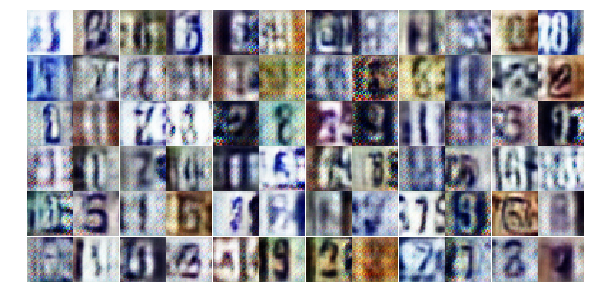

Epoch 7/24... Discriminator Loss: 0.4321... Generator Loss: 1.6504
Epoch 8/24... Discriminator Loss: 0.9463... Generator Loss: 0.6777
Epoch 8/24... Discriminator Loss: 1.4908... Generator Loss: 0.3264
Epoch 8/24... Discriminator Loss: 0.6061... Generator Loss: 1.5729
Epoch 8/24... Discriminator Loss: 0.5345... Generator Loss: 1.7714
Epoch 8/24... Discriminator Loss: 1.0043... Generator Loss: 0.7168
Epoch 8/24... Discriminator Loss: 0.6279... Generator Loss: 1.2181
Epoch 8/24... Discriminator Loss: 0.4767... Generator Loss: 1.3236
Epoch 8/24... Discriminator Loss: 0.7373... Generator Loss: 1.1801
Epoch 8/24... Discriminator Loss: 0.5584... Generator Loss: 1.5085


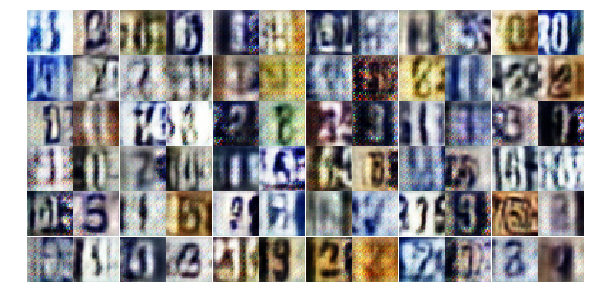

Epoch 8/24... Discriminator Loss: 0.3153... Generator Loss: 2.1715
Epoch 8/24... Discriminator Loss: 0.2558... Generator Loss: 2.0250
Epoch 8/24... Discriminator Loss: 0.6893... Generator Loss: 1.4944
Epoch 8/24... Discriminator Loss: 0.5049... Generator Loss: 1.3795
Epoch 8/24... Discriminator Loss: 0.9777... Generator Loss: 0.6149
Epoch 8/24... Discriminator Loss: 0.4627... Generator Loss: 2.1894
Epoch 8/24... Discriminator Loss: 0.6105... Generator Loss: 1.5900
Epoch 8/24... Discriminator Loss: 0.7835... Generator Loss: 1.0458
Epoch 8/24... Discriminator Loss: 0.5056... Generator Loss: 1.5781
Epoch 8/24... Discriminator Loss: 1.2213... Generator Loss: 0.4981


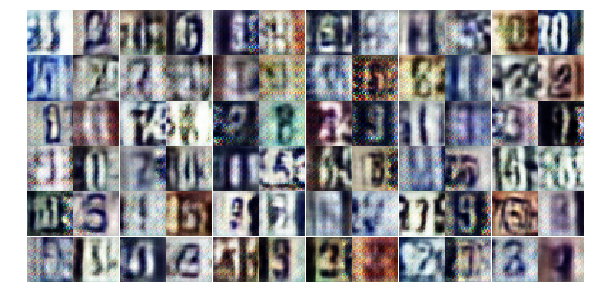

Epoch 8/24... Discriminator Loss: 0.4388... Generator Loss: 1.5524
Epoch 8/24... Discriminator Loss: 0.7328... Generator Loss: 0.9800
Epoch 8/24... Discriminator Loss: 0.8612... Generator Loss: 0.8766
Epoch 8/24... Discriminator Loss: 0.8415... Generator Loss: 0.8757
Epoch 8/24... Discriminator Loss: 0.5311... Generator Loss: 1.3676
Epoch 8/24... Discriminator Loss: 0.5132... Generator Loss: 1.5785
Epoch 8/24... Discriminator Loss: 0.6319... Generator Loss: 1.3514
Epoch 8/24... Discriminator Loss: 0.8274... Generator Loss: 0.7894
Epoch 8/24... Discriminator Loss: 0.6784... Generator Loss: 1.5537
Epoch 8/24... Discriminator Loss: 0.8980... Generator Loss: 0.7085


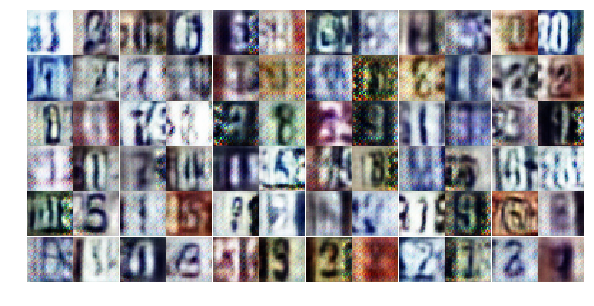

Epoch 8/24... Discriminator Loss: 0.5318... Generator Loss: 1.3395
Epoch 8/24... Discriminator Loss: 0.6171... Generator Loss: 1.0820
Epoch 8/24... Discriminator Loss: 0.6321... Generator Loss: 1.0088
Epoch 8/24... Discriminator Loss: 0.9535... Generator Loss: 0.6993
Epoch 8/24... Discriminator Loss: 0.5545... Generator Loss: 1.2605
Epoch 8/24... Discriminator Loss: 0.6979... Generator Loss: 0.9581
Epoch 8/24... Discriminator Loss: 0.4455... Generator Loss: 1.4629
Epoch 8/24... Discriminator Loss: 2.7534... Generator Loss: 0.0976
Epoch 8/24... Discriminator Loss: 1.1484... Generator Loss: 0.5952
Epoch 8/24... Discriminator Loss: 0.9006... Generator Loss: 0.7429


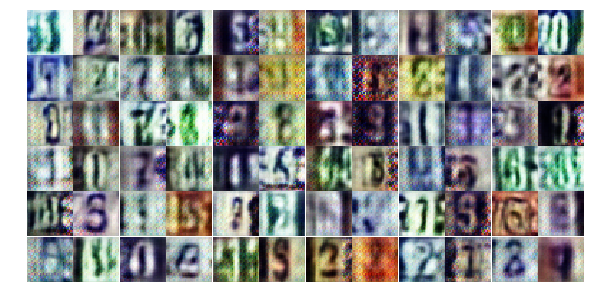

Epoch 8/24... Discriminator Loss: 0.7029... Generator Loss: 2.9183
Epoch 8/24... Discriminator Loss: 1.0430... Generator Loss: 0.6030
Epoch 8/24... Discriminator Loss: 0.7054... Generator Loss: 0.9081
Epoch 8/24... Discriminator Loss: 0.5470... Generator Loss: 1.2281
Epoch 8/24... Discriminator Loss: 0.7362... Generator Loss: 1.7559
Epoch 8/24... Discriminator Loss: 1.1673... Generator Loss: 0.5507
Epoch 8/24... Discriminator Loss: 0.3879... Generator Loss: 1.7112
Epoch 8/24... Discriminator Loss: 0.9803... Generator Loss: 0.6649
Epoch 8/24... Discriminator Loss: 0.7519... Generator Loss: 0.8658
Epoch 8/24... Discriminator Loss: 1.0493... Generator Loss: 0.6242


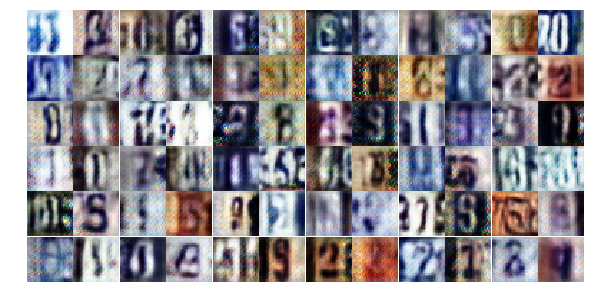

Epoch 8/24... Discriminator Loss: 0.8939... Generator Loss: 0.8190
Epoch 8/24... Discriminator Loss: 0.5783... Generator Loss: 1.0740
Epoch 8/24... Discriminator Loss: 0.5178... Generator Loss: 1.5211
Epoch 8/24... Discriminator Loss: 2.0869... Generator Loss: 0.1776
Epoch 8/24... Discriminator Loss: 0.7087... Generator Loss: 1.8020
Epoch 8/24... Discriminator Loss: 1.4886... Generator Loss: 2.6445
Epoch 8/24... Discriminator Loss: 0.8199... Generator Loss: 0.8309
Epoch 8/24... Discriminator Loss: 0.7334... Generator Loss: 2.2597
Epoch 9/24... Discriminator Loss: 0.6454... Generator Loss: 1.9523
Epoch 9/24... Discriminator Loss: 1.2110... Generator Loss: 0.4799


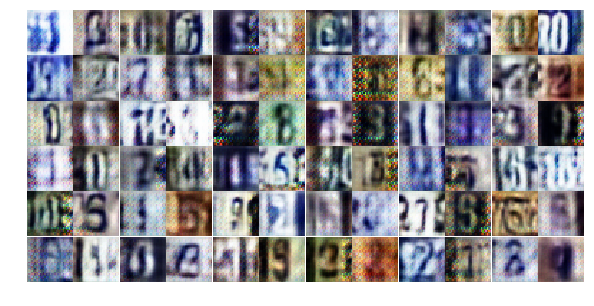

Epoch 9/24... Discriminator Loss: 0.6354... Generator Loss: 1.3211
Epoch 9/24... Discriminator Loss: 0.7527... Generator Loss: 1.4306
Epoch 9/24... Discriminator Loss: 1.0800... Generator Loss: 0.6493
Epoch 9/24... Discriminator Loss: 0.3576... Generator Loss: 2.0850
Epoch 9/24... Discriminator Loss: 0.7751... Generator Loss: 1.0188
Epoch 9/24... Discriminator Loss: 0.6351... Generator Loss: 1.9703
Epoch 9/24... Discriminator Loss: 0.5573... Generator Loss: 1.3288
Epoch 9/24... Discriminator Loss: 0.5464... Generator Loss: 1.1694
Epoch 9/24... Discriminator Loss: 0.3288... Generator Loss: 1.6631
Epoch 9/24... Discriminator Loss: 0.4050... Generator Loss: 1.4882


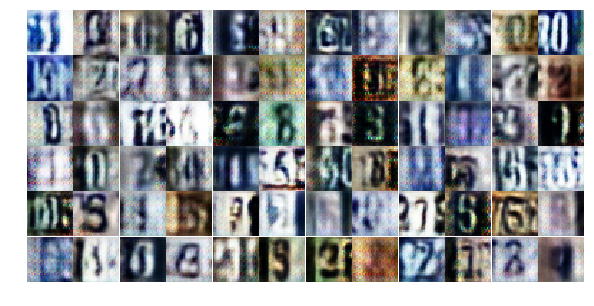

Epoch 9/24... Discriminator Loss: 0.6710... Generator Loss: 1.3371
Epoch 9/24... Discriminator Loss: 0.8452... Generator Loss: 0.8663
Epoch 9/24... Discriminator Loss: 0.8061... Generator Loss: 0.9454
Epoch 9/24... Discriminator Loss: 0.9767... Generator Loss: 0.6869
Epoch 9/24... Discriminator Loss: 0.7561... Generator Loss: 0.9429
Epoch 9/24... Discriminator Loss: 0.8317... Generator Loss: 0.8075
Epoch 9/24... Discriminator Loss: 1.1057... Generator Loss: 0.5442
Epoch 9/24... Discriminator Loss: 0.7544... Generator Loss: 0.8258
Epoch 9/24... Discriminator Loss: 0.7276... Generator Loss: 0.8688
Epoch 9/24... Discriminator Loss: 1.1610... Generator Loss: 0.5522


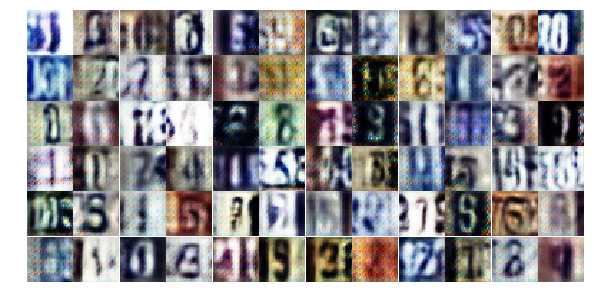

Epoch 9/24... Discriminator Loss: 1.2061... Generator Loss: 0.5616
Epoch 9/24... Discriminator Loss: 0.7688... Generator Loss: 0.9337
Epoch 9/24... Discriminator Loss: 0.6594... Generator Loss: 1.1254
Epoch 9/24... Discriminator Loss: 0.4482... Generator Loss: 1.6766
Epoch 9/24... Discriminator Loss: 0.4462... Generator Loss: 1.5595
Epoch 9/24... Discriminator Loss: 0.5125... Generator Loss: 1.3822
Epoch 9/24... Discriminator Loss: 0.9489... Generator Loss: 0.7072
Epoch 9/24... Discriminator Loss: 0.6027... Generator Loss: 1.2049
Epoch 9/24... Discriminator Loss: 0.5930... Generator Loss: 1.0803
Epoch 9/24... Discriminator Loss: 1.0250... Generator Loss: 0.5828


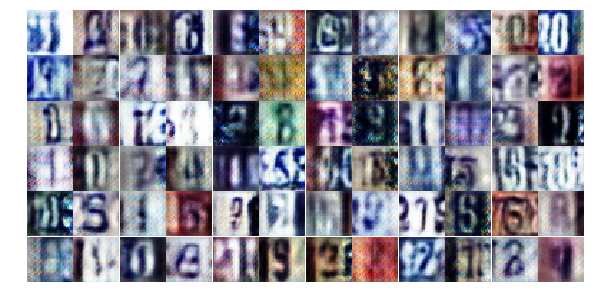

Epoch 9/24... Discriminator Loss: 0.4972... Generator Loss: 1.3065
Epoch 9/24... Discriminator Loss: 1.0737... Generator Loss: 0.5891
Epoch 9/24... Discriminator Loss: 1.0391... Generator Loss: 0.6115
Epoch 9/24... Discriminator Loss: 0.6601... Generator Loss: 0.9592
Epoch 9/24... Discriminator Loss: 0.5690... Generator Loss: 1.2519
Epoch 9/24... Discriminator Loss: 0.8987... Generator Loss: 0.7683
Epoch 9/24... Discriminator Loss: 0.5946... Generator Loss: 1.1893
Epoch 9/24... Discriminator Loss: 0.2742... Generator Loss: 1.9077
Epoch 9/24... Discriminator Loss: 0.9324... Generator Loss: 0.7467
Epoch 9/24... Discriminator Loss: 0.6295... Generator Loss: 1.0627


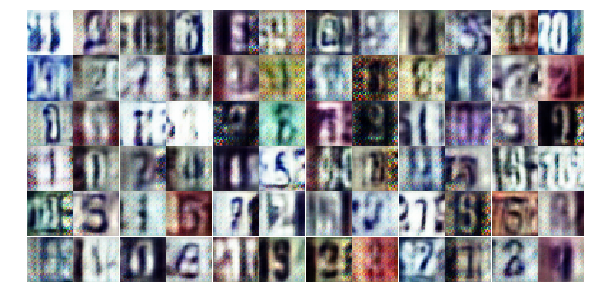

Epoch 9/24... Discriminator Loss: 0.5908... Generator Loss: 1.1026
Epoch 9/24... Discriminator Loss: 0.7009... Generator Loss: 1.5803
Epoch 9/24... Discriminator Loss: 0.4896... Generator Loss: 1.5986
Epoch 9/24... Discriminator Loss: 0.6232... Generator Loss: 1.5414
Epoch 9/24... Discriminator Loss: 0.4250... Generator Loss: 1.7263
Epoch 9/24... Discriminator Loss: 0.7802... Generator Loss: 0.8866
Epoch 9/24... Discriminator Loss: 0.9455... Generator Loss: 0.6977
Epoch 9/24... Discriminator Loss: 0.5958... Generator Loss: 1.3887
Epoch 9/24... Discriminator Loss: 0.6816... Generator Loss: 1.0419
Epoch 9/24... Discriminator Loss: 0.7781... Generator Loss: 2.5749


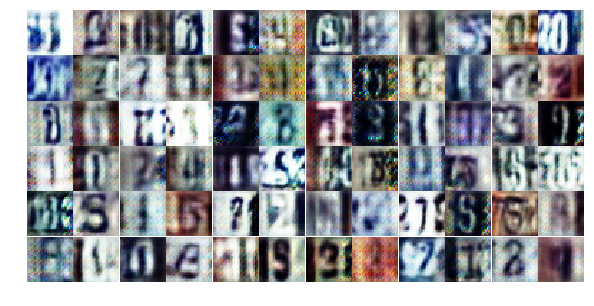

Epoch 9/24... Discriminator Loss: 1.3786... Generator Loss: 0.4229
Epoch 9/24... Discriminator Loss: 1.3050... Generator Loss: 2.5677
Epoch 9/24... Discriminator Loss: 1.0199... Generator Loss: 0.6283
Epoch 9/24... Discriminator Loss: 1.0365... Generator Loss: 0.5885
Epoch 9/24... Discriminator Loss: 0.6235... Generator Loss: 1.1681
Epoch 10/24... Discriminator Loss: 0.6166... Generator Loss: 1.0799
Epoch 10/24... Discriminator Loss: 0.5007... Generator Loss: 1.2828
Epoch 10/24... Discriminator Loss: 0.5963... Generator Loss: 1.1280
Epoch 10/24... Discriminator Loss: 0.7072... Generator Loss: 0.9885
Epoch 10/24... Discriminator Loss: 1.7007... Generator Loss: 0.3117


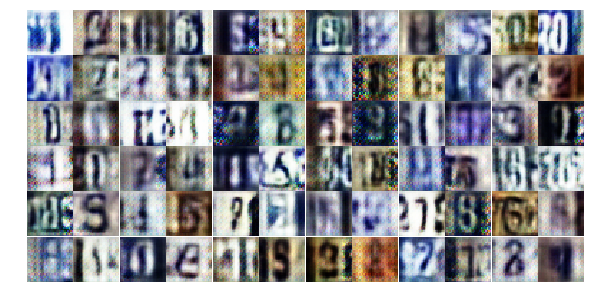

Epoch 10/24... Discriminator Loss: 0.9298... Generator Loss: 0.8791
Epoch 10/24... Discriminator Loss: 0.5594... Generator Loss: 1.3327
Epoch 10/24... Discriminator Loss: 0.8454... Generator Loss: 0.7493
Epoch 10/24... Discriminator Loss: 0.5824... Generator Loss: 1.3859
Epoch 10/24... Discriminator Loss: 0.4695... Generator Loss: 1.5881
Epoch 10/24... Discriminator Loss: 0.7752... Generator Loss: 0.8954
Epoch 10/24... Discriminator Loss: 0.4551... Generator Loss: 1.4144
Epoch 10/24... Discriminator Loss: 1.5533... Generator Loss: 0.3406
Epoch 10/24... Discriminator Loss: 0.8392... Generator Loss: 0.8514
Epoch 10/24... Discriminator Loss: 0.8997... Generator Loss: 0.8638


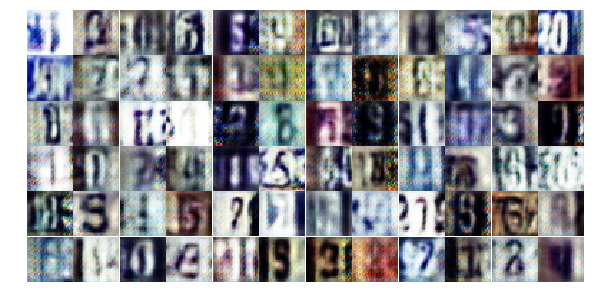

Epoch 10/24... Discriminator Loss: 0.5748... Generator Loss: 1.3786
Epoch 10/24... Discriminator Loss: 1.1733... Generator Loss: 0.5161
Epoch 10/24... Discriminator Loss: 0.8177... Generator Loss: 0.7545
Epoch 10/24... Discriminator Loss: 1.0208... Generator Loss: 0.6706
Epoch 10/24... Discriminator Loss: 0.5896... Generator Loss: 1.4968
Epoch 10/24... Discriminator Loss: 0.4865... Generator Loss: 1.2938
Epoch 10/24... Discriminator Loss: 1.2602... Generator Loss: 0.4758
Epoch 10/24... Discriminator Loss: 0.4862... Generator Loss: 1.2819
Epoch 10/24... Discriminator Loss: 0.7037... Generator Loss: 1.0787
Epoch 10/24... Discriminator Loss: 0.4641... Generator Loss: 2.2550


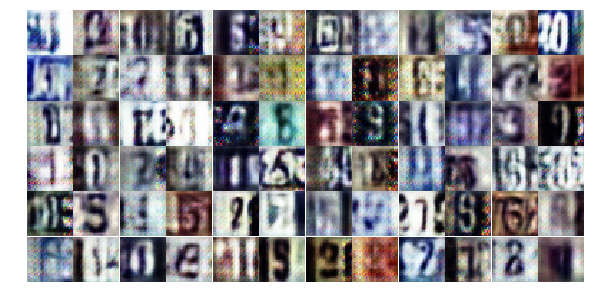

Epoch 10/24... Discriminator Loss: 1.1582... Generator Loss: 0.5340
Epoch 10/24... Discriminator Loss: 0.5922... Generator Loss: 1.2336
Epoch 10/24... Discriminator Loss: 0.6189... Generator Loss: 0.9888
Epoch 10/24... Discriminator Loss: 0.4445... Generator Loss: 1.9980
Epoch 10/24... Discriminator Loss: 1.3627... Generator Loss: 0.4071
Epoch 10/24... Discriminator Loss: 0.6688... Generator Loss: 0.9635
Epoch 10/24... Discriminator Loss: 0.4492... Generator Loss: 1.3811
Epoch 10/24... Discriminator Loss: 0.6437... Generator Loss: 1.8457
Epoch 10/24... Discriminator Loss: 0.2995... Generator Loss: 1.6987
Epoch 10/24... Discriminator Loss: 0.9675... Generator Loss: 2.0748


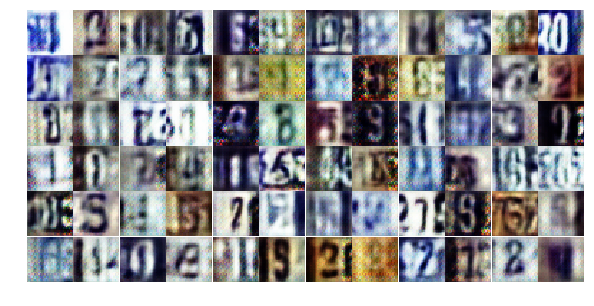

Epoch 10/24... Discriminator Loss: 0.7336... Generator Loss: 0.9793
Epoch 10/24... Discriminator Loss: 0.4223... Generator Loss: 1.7597
Epoch 10/24... Discriminator Loss: 1.0158... Generator Loss: 2.3363
Epoch 10/24... Discriminator Loss: 0.6996... Generator Loss: 1.0054
Epoch 10/24... Discriminator Loss: 0.6087... Generator Loss: 1.0924
Epoch 10/24... Discriminator Loss: 0.4972... Generator Loss: 1.4105
Epoch 10/24... Discriminator Loss: 0.8875... Generator Loss: 0.7099
Epoch 10/24... Discriminator Loss: 0.5911... Generator Loss: 1.1129
Epoch 10/24... Discriminator Loss: 0.6050... Generator Loss: 1.0313
Epoch 10/24... Discriminator Loss: 0.9111... Generator Loss: 2.3570


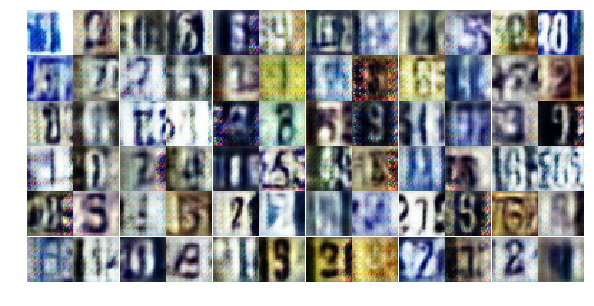

Epoch 10/24... Discriminator Loss: 1.0684... Generator Loss: 0.6880
Epoch 10/24... Discriminator Loss: 0.9880... Generator Loss: 0.6464
Epoch 10/24... Discriminator Loss: 0.8462... Generator Loss: 0.7326
Epoch 10/24... Discriminator Loss: 1.0315... Generator Loss: 0.6664
Epoch 10/24... Discriminator Loss: 0.4062... Generator Loss: 1.6364
Epoch 10/24... Discriminator Loss: 0.5329... Generator Loss: 1.9800
Epoch 10/24... Discriminator Loss: 0.6816... Generator Loss: 0.9252
Epoch 10/24... Discriminator Loss: 0.4109... Generator Loss: 1.9315
Epoch 10/24... Discriminator Loss: 0.8978... Generator Loss: 0.8970
Epoch 10/24... Discriminator Loss: 0.5205... Generator Loss: 1.3634


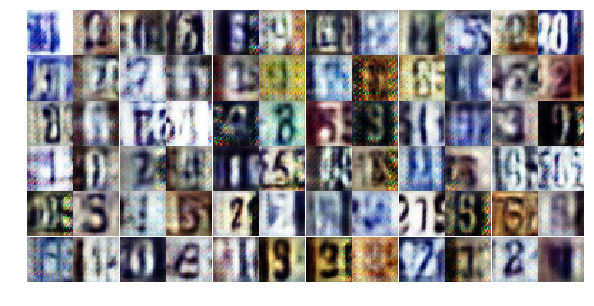

Epoch 10/24... Discriminator Loss: 0.7822... Generator Loss: 0.9663
Epoch 10/24... Discriminator Loss: 0.3995... Generator Loss: 1.5192
Epoch 10/24... Discriminator Loss: 0.5392... Generator Loss: 1.2144
Epoch 11/24... Discriminator Loss: 0.6511... Generator Loss: 1.0822
Epoch 11/24... Discriminator Loss: 0.6430... Generator Loss: 1.0999
Epoch 11/24... Discriminator Loss: 1.1368... Generator Loss: 0.5291
Epoch 11/24... Discriminator Loss: 0.8175... Generator Loss: 0.7558
Epoch 11/24... Discriminator Loss: 0.6873... Generator Loss: 1.2265
Epoch 11/24... Discriminator Loss: 2.0792... Generator Loss: 0.1836
Epoch 11/24... Discriminator Loss: 0.4423... Generator Loss: 1.6409


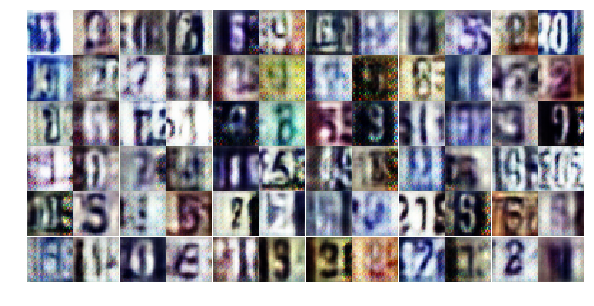

Epoch 11/24... Discriminator Loss: 0.5241... Generator Loss: 1.2701
Epoch 11/24... Discriminator Loss: 0.6557... Generator Loss: 1.0947
Epoch 11/24... Discriminator Loss: 0.7308... Generator Loss: 0.9693
Epoch 11/24... Discriminator Loss: 0.5060... Generator Loss: 1.5734
Epoch 11/24... Discriminator Loss: 0.7500... Generator Loss: 0.9961
Epoch 11/24... Discriminator Loss: 0.3000... Generator Loss: 2.0014
Epoch 11/24... Discriminator Loss: 0.5710... Generator Loss: 1.4124
Epoch 11/24... Discriminator Loss: 0.2830... Generator Loss: 2.2418
Epoch 11/24... Discriminator Loss: 0.6978... Generator Loss: 1.0864
Epoch 11/24... Discriminator Loss: 1.0563... Generator Loss: 0.5941


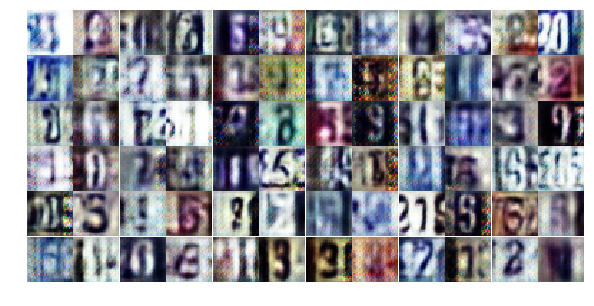

Epoch 11/24... Discriminator Loss: 0.8844... Generator Loss: 0.7472
Epoch 11/24... Discriminator Loss: 0.3356... Generator Loss: 1.9473
Epoch 11/24... Discriminator Loss: 1.1410... Generator Loss: 0.5868
Epoch 11/24... Discriminator Loss: 0.7501... Generator Loss: 0.8607
Epoch 11/24... Discriminator Loss: 0.3476... Generator Loss: 1.9252
Epoch 11/24... Discriminator Loss: 0.4029... Generator Loss: 1.4720
Epoch 11/24... Discriminator Loss: 0.6532... Generator Loss: 0.9822
Epoch 11/24... Discriminator Loss: 0.7580... Generator Loss: 0.8271
Epoch 11/24... Discriminator Loss: 0.4675... Generator Loss: 1.4120
Epoch 11/24... Discriminator Loss: 1.8449... Generator Loss: 0.2492


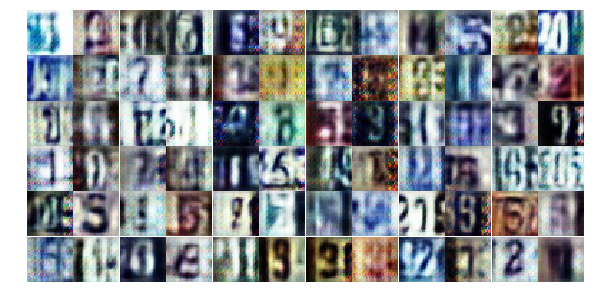

Epoch 11/24... Discriminator Loss: 1.7115... Generator Loss: 0.2709
Epoch 11/24... Discriminator Loss: 1.0379... Generator Loss: 0.6445
Epoch 11/24... Discriminator Loss: 0.9427... Generator Loss: 0.7223
Epoch 11/24... Discriminator Loss: 0.6389... Generator Loss: 1.2231
Epoch 11/24... Discriminator Loss: 0.6939... Generator Loss: 0.9658
Epoch 11/24... Discriminator Loss: 1.2356... Generator Loss: 0.4925
Epoch 11/24... Discriminator Loss: 1.3112... Generator Loss: 0.4502
Epoch 11/24... Discriminator Loss: 1.1828... Generator Loss: 0.5094
Epoch 11/24... Discriminator Loss: 0.4871... Generator Loss: 1.3699
Epoch 11/24... Discriminator Loss: 0.8501... Generator Loss: 0.7592


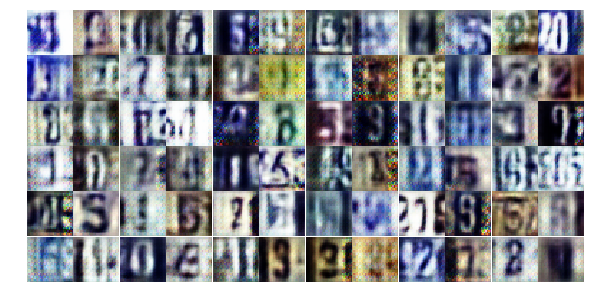

Epoch 11/24... Discriminator Loss: 0.4213... Generator Loss: 1.5851
Epoch 11/24... Discriminator Loss: 0.4543... Generator Loss: 1.6689
Epoch 11/24... Discriminator Loss: 0.6639... Generator Loss: 0.9698
Epoch 11/24... Discriminator Loss: 0.6485... Generator Loss: 2.3437
Epoch 11/24... Discriminator Loss: 0.9459... Generator Loss: 0.6838
Epoch 11/24... Discriminator Loss: 0.8225... Generator Loss: 0.8258
Epoch 11/24... Discriminator Loss: 0.2773... Generator Loss: 2.2037
Epoch 11/24... Discriminator Loss: 0.8240... Generator Loss: 0.8488
Epoch 11/24... Discriminator Loss: 1.2106... Generator Loss: 0.5099
Epoch 11/24... Discriminator Loss: 0.7258... Generator Loss: 0.8521


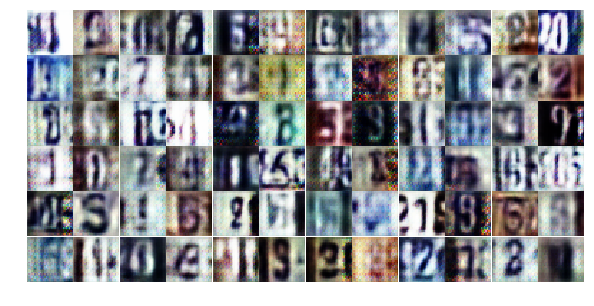

Epoch 11/24... Discriminator Loss: 0.9684... Generator Loss: 0.7225
Epoch 11/24... Discriminator Loss: 0.5650... Generator Loss: 1.1862
Epoch 11/24... Discriminator Loss: 0.4534... Generator Loss: 1.8987
Epoch 11/24... Discriminator Loss: 0.5635... Generator Loss: 1.1908
Epoch 11/24... Discriminator Loss: 1.3473... Generator Loss: 0.4097
Epoch 11/24... Discriminator Loss: 1.0546... Generator Loss: 0.6451
Epoch 11/24... Discriminator Loss: 1.6993... Generator Loss: 0.3124
Epoch 11/24... Discriminator Loss: 0.5447... Generator Loss: 1.3488
Epoch 11/24... Discriminator Loss: 0.8460... Generator Loss: 0.8029
Epoch 11/24... Discriminator Loss: 0.9446... Generator Loss: 0.6966


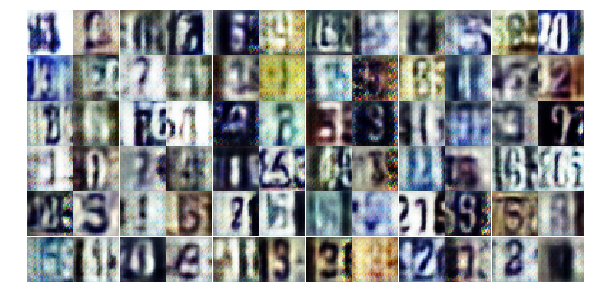

Epoch 12/24... Discriminator Loss: 0.5639... Generator Loss: 1.2450
Epoch 12/24... Discriminator Loss: 0.9533... Generator Loss: 0.6977
Epoch 12/24... Discriminator Loss: 0.7818... Generator Loss: 0.9120
Epoch 12/24... Discriminator Loss: 0.3598... Generator Loss: 2.0711
Epoch 12/24... Discriminator Loss: 0.3656... Generator Loss: 1.6602
Epoch 12/24... Discriminator Loss: 1.2754... Generator Loss: 0.4838
Epoch 12/24... Discriminator Loss: 0.7305... Generator Loss: 1.5930
Epoch 12/24... Discriminator Loss: 0.6913... Generator Loss: 1.0229
Epoch 12/24... Discriminator Loss: 0.7515... Generator Loss: 1.4106
Epoch 12/24... Discriminator Loss: 1.5531... Generator Loss: 0.3843


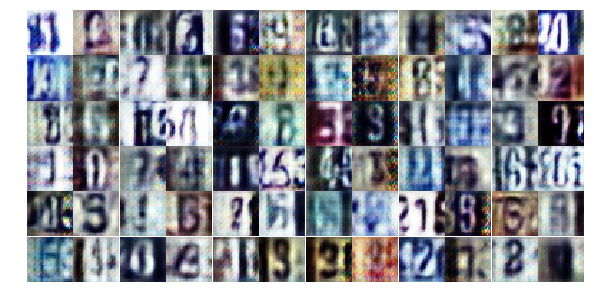

Epoch 12/24... Discriminator Loss: 0.7365... Generator Loss: 1.0215
Epoch 12/24... Discriminator Loss: 1.3370... Generator Loss: 0.3932
Epoch 12/24... Discriminator Loss: 1.5498... Generator Loss: 3.2743
Epoch 12/24... Discriminator Loss: 0.7751... Generator Loss: 1.3210
Epoch 12/24... Discriminator Loss: 0.4906... Generator Loss: 1.3660
Epoch 12/24... Discriminator Loss: 0.8058... Generator Loss: 0.8285
Epoch 12/24... Discriminator Loss: 1.4256... Generator Loss: 0.3908
Epoch 12/24... Discriminator Loss: 0.7628... Generator Loss: 1.2258
Epoch 12/24... Discriminator Loss: 0.8000... Generator Loss: 0.7828
Epoch 12/24... Discriminator Loss: 0.7078... Generator Loss: 0.9492


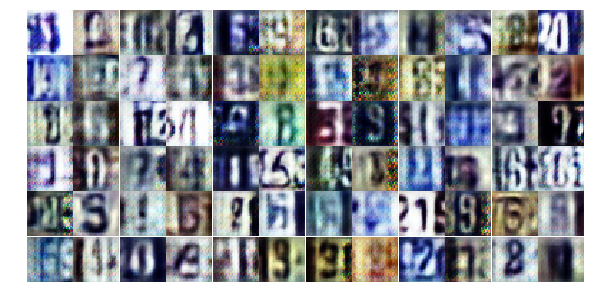

Epoch 12/24... Discriminator Loss: 0.4186... Generator Loss: 1.4426
Epoch 12/24... Discriminator Loss: 0.6067... Generator Loss: 1.1484
Epoch 12/24... Discriminator Loss: 0.7972... Generator Loss: 0.9133
Epoch 12/24... Discriminator Loss: 0.4238... Generator Loss: 1.5308
Epoch 12/24... Discriminator Loss: 0.4398... Generator Loss: 1.4228
Epoch 12/24... Discriminator Loss: 0.5357... Generator Loss: 1.2438
Epoch 12/24... Discriminator Loss: 0.9464... Generator Loss: 0.7095
Epoch 12/24... Discriminator Loss: 0.3594... Generator Loss: 1.7889
Epoch 12/24... Discriminator Loss: 0.5196... Generator Loss: 1.1647
Epoch 12/24... Discriminator Loss: 0.8724... Generator Loss: 0.7329


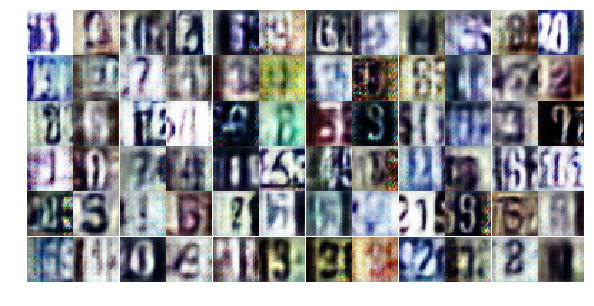

Epoch 12/24... Discriminator Loss: 0.7153... Generator Loss: 0.9253
Epoch 12/24... Discriminator Loss: 0.8015... Generator Loss: 0.8287
Epoch 12/24... Discriminator Loss: 0.9508... Generator Loss: 0.6665
Epoch 12/24... Discriminator Loss: 1.7951... Generator Loss: 0.2643
Epoch 12/24... Discriminator Loss: 0.8909... Generator Loss: 2.6091
Epoch 12/24... Discriminator Loss: 0.9439... Generator Loss: 0.7030
Epoch 12/24... Discriminator Loss: 1.2582... Generator Loss: 0.5029
Epoch 12/24... Discriminator Loss: 0.8600... Generator Loss: 0.8582
Epoch 12/24... Discriminator Loss: 0.4806... Generator Loss: 1.3226
Epoch 12/24... Discriminator Loss: 0.2583... Generator Loss: 2.0806


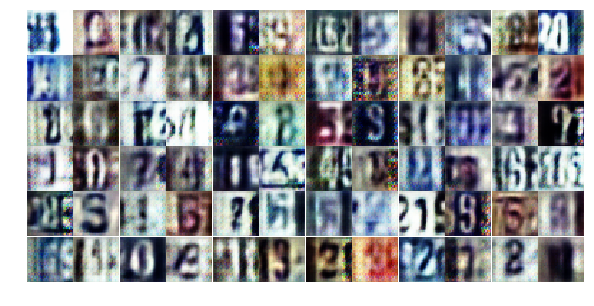

Epoch 12/24... Discriminator Loss: 0.8869... Generator Loss: 0.7197
Epoch 12/24... Discriminator Loss: 0.5307... Generator Loss: 1.0979
Epoch 12/24... Discriminator Loss: 0.5736... Generator Loss: 3.0160
Epoch 12/24... Discriminator Loss: 0.9909... Generator Loss: 0.8308
Epoch 12/24... Discriminator Loss: 0.7958... Generator Loss: 0.8902
Epoch 12/24... Discriminator Loss: 1.1231... Generator Loss: 0.6081
Epoch 12/24... Discriminator Loss: 0.7854... Generator Loss: 0.9287
Epoch 12/24... Discriminator Loss: 0.8181... Generator Loss: 0.9257
Epoch 12/24... Discriminator Loss: 0.5004... Generator Loss: 1.3482
Epoch 12/24... Discriminator Loss: 0.5110... Generator Loss: 1.3341


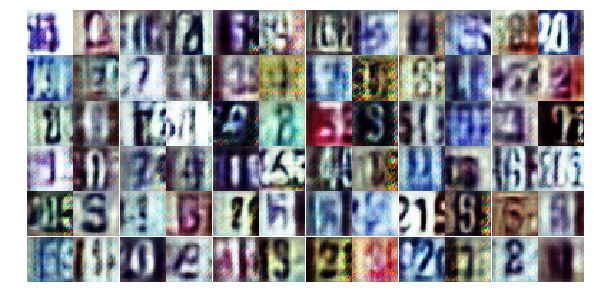

Epoch 12/24... Discriminator Loss: 1.4351... Generator Loss: 0.4188
Epoch 12/24... Discriminator Loss: 0.8770... Generator Loss: 0.7870
Epoch 12/24... Discriminator Loss: 0.7255... Generator Loss: 0.9179
Epoch 12/24... Discriminator Loss: 0.8394... Generator Loss: 1.8259
Epoch 12/24... Discriminator Loss: 0.3580... Generator Loss: 1.6909
Epoch 12/24... Discriminator Loss: 0.7375... Generator Loss: 2.2887
Epoch 12/24... Discriminator Loss: 1.8052... Generator Loss: 0.2452
Epoch 13/24... Discriminator Loss: 0.5712... Generator Loss: 1.4265
Epoch 13/24... Discriminator Loss: 0.4443... Generator Loss: 1.4893
Epoch 13/24... Discriminator Loss: 0.7000... Generator Loss: 0.9688


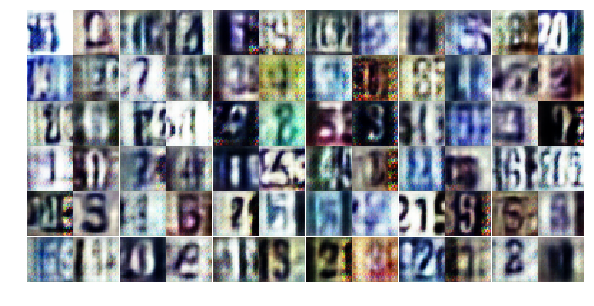

Epoch 13/24... Discriminator Loss: 0.5917... Generator Loss: 1.1583
Epoch 13/24... Discriminator Loss: 1.0700... Generator Loss: 3.2606
Epoch 13/24... Discriminator Loss: 0.9436... Generator Loss: 0.7263
Epoch 13/24... Discriminator Loss: 1.2320... Generator Loss: 0.4936
Epoch 13/24... Discriminator Loss: 0.5557... Generator Loss: 1.1567
Epoch 13/24... Discriminator Loss: 0.9071... Generator Loss: 0.7143
Epoch 13/24... Discriminator Loss: 0.3985... Generator Loss: 1.6813
Epoch 13/24... Discriminator Loss: 0.5783... Generator Loss: 1.1412
Epoch 13/24... Discriminator Loss: 0.7262... Generator Loss: 0.9647
Epoch 13/24... Discriminator Loss: 0.5248... Generator Loss: 1.9763


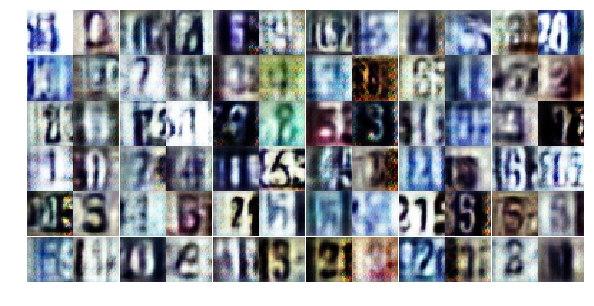

Epoch 13/24... Discriminator Loss: 0.5574... Generator Loss: 1.4921
Epoch 13/24... Discriminator Loss: 0.3189... Generator Loss: 1.8434
Epoch 13/24... Discriminator Loss: 1.1458... Generator Loss: 0.5604
Epoch 13/24... Discriminator Loss: 0.7331... Generator Loss: 1.2187
Epoch 13/24... Discriminator Loss: 0.7020... Generator Loss: 1.0164
Epoch 13/24... Discriminator Loss: 0.9209... Generator Loss: 0.8472
Epoch 13/24... Discriminator Loss: 0.8320... Generator Loss: 0.9479
Epoch 13/24... Discriminator Loss: 1.9649... Generator Loss: 0.2372
Epoch 13/24... Discriminator Loss: 0.6585... Generator Loss: 2.7356
Epoch 13/24... Discriminator Loss: 1.4940... Generator Loss: 0.3491


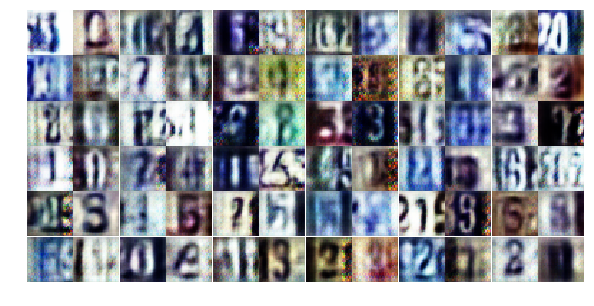

Epoch 13/24... Discriminator Loss: 0.5559... Generator Loss: 1.1730
Epoch 13/24... Discriminator Loss: 0.5616... Generator Loss: 1.2962
Epoch 13/24... Discriminator Loss: 0.4274... Generator Loss: 1.7929
Epoch 13/24... Discriminator Loss: 0.6091... Generator Loss: 1.2011
Epoch 13/24... Discriminator Loss: 0.7597... Generator Loss: 0.8851
Epoch 13/24... Discriminator Loss: 0.9047... Generator Loss: 0.7809
Epoch 13/24... Discriminator Loss: 0.8744... Generator Loss: 1.9087
Epoch 13/24... Discriminator Loss: 0.4700... Generator Loss: 1.3513
Epoch 13/24... Discriminator Loss: 1.5042... Generator Loss: 0.3821
Epoch 13/24... Discriminator Loss: 0.5558... Generator Loss: 1.4708


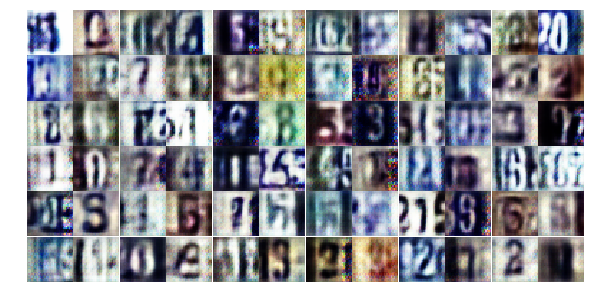

Epoch 13/24... Discriminator Loss: 1.0529... Generator Loss: 0.6143
Epoch 13/24... Discriminator Loss: 0.8135... Generator Loss: 0.8571
Epoch 13/24... Discriminator Loss: 0.7170... Generator Loss: 0.9975
Epoch 13/24... Discriminator Loss: 1.3038... Generator Loss: 0.4680
Epoch 13/24... Discriminator Loss: 0.7540... Generator Loss: 0.8355
Epoch 13/24... Discriminator Loss: 0.4579... Generator Loss: 1.3119
Epoch 13/24... Discriminator Loss: 0.4672... Generator Loss: 1.3304
Epoch 13/24... Discriminator Loss: 0.3578... Generator Loss: 1.6078
Epoch 13/24... Discriminator Loss: 0.4146... Generator Loss: 2.5069
Epoch 13/24... Discriminator Loss: 0.3411... Generator Loss: 2.2333


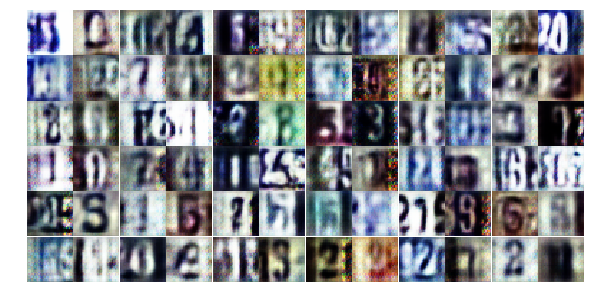

Epoch 13/24... Discriminator Loss: 0.7879... Generator Loss: 2.2302
Epoch 13/24... Discriminator Loss: 1.2343... Generator Loss: 0.5433
Epoch 13/24... Discriminator Loss: 0.8981... Generator Loss: 0.7728
Epoch 13/24... Discriminator Loss: 0.6738... Generator Loss: 0.9425
Epoch 13/24... Discriminator Loss: 1.2021... Generator Loss: 0.5248
Epoch 13/24... Discriminator Loss: 0.7400... Generator Loss: 0.9055
Epoch 13/24... Discriminator Loss: 0.6004... Generator Loss: 1.1368
Epoch 13/24... Discriminator Loss: 0.5721... Generator Loss: 1.3322
Epoch 13/24... Discriminator Loss: 0.6508... Generator Loss: 0.9914
Epoch 13/24... Discriminator Loss: 1.0080... Generator Loss: 0.5909


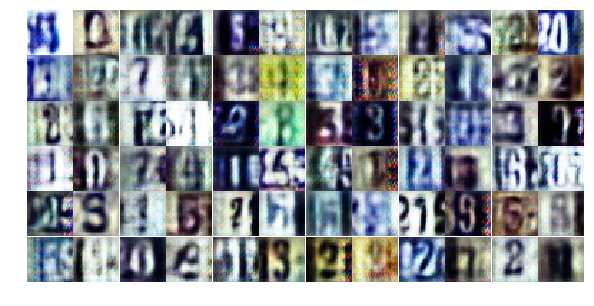

Epoch 13/24... Discriminator Loss: 0.2541... Generator Loss: 2.1832
Epoch 13/24... Discriminator Loss: 1.1358... Generator Loss: 0.5682
Epoch 13/24... Discriminator Loss: 0.5019... Generator Loss: 1.2859
Epoch 13/24... Discriminator Loss: 0.6541... Generator Loss: 1.0555
Epoch 14/24... Discriminator Loss: 0.6132... Generator Loss: 1.0492
Epoch 14/24... Discriminator Loss: 0.8743... Generator Loss: 0.7563
Epoch 14/24... Discriminator Loss: 0.9904... Generator Loss: 0.6991
Epoch 14/24... Discriminator Loss: 0.6899... Generator Loss: 1.1066
Epoch 14/24... Discriminator Loss: 0.6955... Generator Loss: 0.9845
Epoch 14/24... Discriminator Loss: 1.0797... Generator Loss: 0.5811


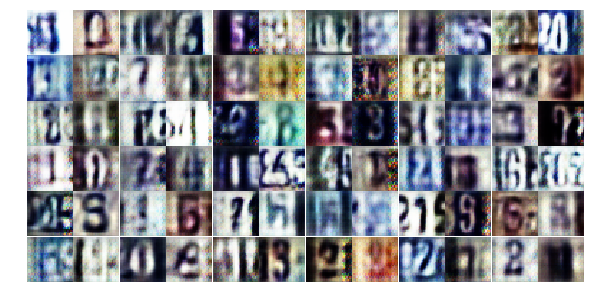

Epoch 14/24... Discriminator Loss: 0.7607... Generator Loss: 1.4956
Epoch 14/24... Discriminator Loss: 0.6109... Generator Loss: 1.0517
Epoch 14/24... Discriminator Loss: 0.8225... Generator Loss: 0.7807
Epoch 14/24... Discriminator Loss: 0.7530... Generator Loss: 0.8227
Epoch 14/24... Discriminator Loss: 0.9052... Generator Loss: 0.7830
Epoch 14/24... Discriminator Loss: 0.4054... Generator Loss: 1.4105
Epoch 14/24... Discriminator Loss: 0.4905... Generator Loss: 1.3843
Epoch 14/24... Discriminator Loss: 1.0486... Generator Loss: 0.6283
Epoch 14/24... Discriminator Loss: 1.1719... Generator Loss: 0.5001
Epoch 14/24... Discriminator Loss: 0.9680... Generator Loss: 0.6709


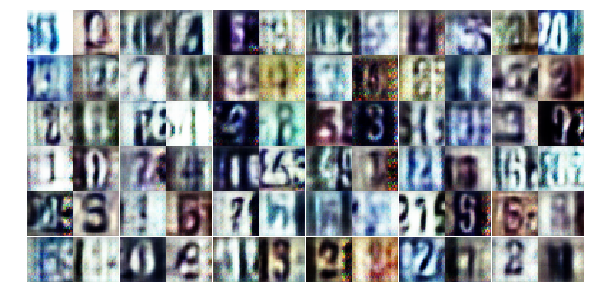

Epoch 14/24... Discriminator Loss: 0.7515... Generator Loss: 0.8442
Epoch 14/24... Discriminator Loss: 0.6026... Generator Loss: 2.5890
Epoch 14/24... Discriminator Loss: 0.6817... Generator Loss: 1.3120
Epoch 14/24... Discriminator Loss: 0.9840... Generator Loss: 0.6447
Epoch 14/24... Discriminator Loss: 0.9333... Generator Loss: 0.7498
Epoch 14/24... Discriminator Loss: 0.7722... Generator Loss: 0.9161
Epoch 14/24... Discriminator Loss: 0.7301... Generator Loss: 0.9584
Epoch 14/24... Discriminator Loss: 0.4805... Generator Loss: 1.5231
Epoch 14/24... Discriminator Loss: 0.6589... Generator Loss: 0.9410
Epoch 14/24... Discriminator Loss: 0.5147... Generator Loss: 1.3374


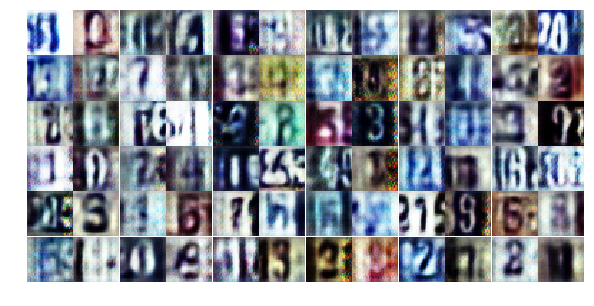

Epoch 14/24... Discriminator Loss: 1.5184... Generator Loss: 0.4168
Epoch 14/24... Discriminator Loss: 0.5066... Generator Loss: 1.1677
Epoch 14/24... Discriminator Loss: 0.8633... Generator Loss: 0.7593
Epoch 14/24... Discriminator Loss: 0.5212... Generator Loss: 1.3339
Epoch 14/24... Discriminator Loss: 0.5653... Generator Loss: 1.4039
Epoch 14/24... Discriminator Loss: 1.0793... Generator Loss: 0.6493
Epoch 14/24... Discriminator Loss: 0.5880... Generator Loss: 1.1988
Epoch 14/24... Discriminator Loss: 0.3297... Generator Loss: 1.7031
Epoch 14/24... Discriminator Loss: 0.4612... Generator Loss: 2.5453
Epoch 14/24... Discriminator Loss: 0.6227... Generator Loss: 1.1130


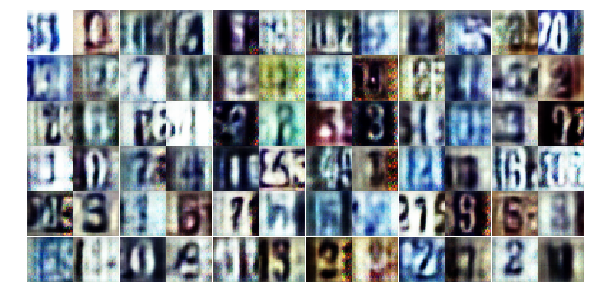

Epoch 14/24... Discriminator Loss: 0.7166... Generator Loss: 0.9116
Epoch 14/24... Discriminator Loss: 0.8968... Generator Loss: 0.8769
Epoch 14/24... Discriminator Loss: 1.1795... Generator Loss: 0.5575
Epoch 14/24... Discriminator Loss: 1.6584... Generator Loss: 0.3293
Epoch 14/24... Discriminator Loss: 0.6955... Generator Loss: 0.8795
Epoch 14/24... Discriminator Loss: 1.1900... Generator Loss: 0.5156
Epoch 14/24... Discriminator Loss: 0.6182... Generator Loss: 1.7441
Epoch 14/24... Discriminator Loss: 0.7861... Generator Loss: 0.9298
Epoch 14/24... Discriminator Loss: 1.0631... Generator Loss: 0.6671
Epoch 14/24... Discriminator Loss: 1.0459... Generator Loss: 0.6609


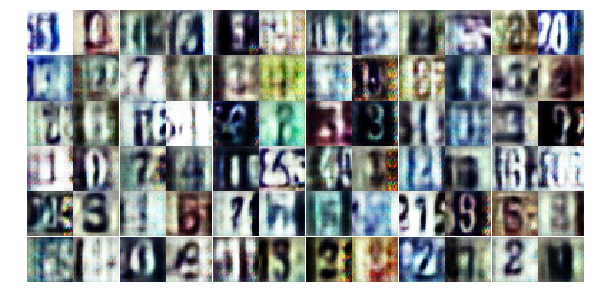

Epoch 14/24... Discriminator Loss: 1.0942... Generator Loss: 0.5536
Epoch 14/24... Discriminator Loss: 1.7817... Generator Loss: 0.2542
Epoch 14/24... Discriminator Loss: 0.6620... Generator Loss: 1.1799
Epoch 14/24... Discriminator Loss: 0.4180... Generator Loss: 1.5449
Epoch 14/24... Discriminator Loss: 0.7064... Generator Loss: 0.9282
Epoch 14/24... Discriminator Loss: 0.5099... Generator Loss: 1.2790
Epoch 14/24... Discriminator Loss: 1.0491... Generator Loss: 0.6660
Epoch 14/24... Discriminator Loss: 0.8846... Generator Loss: 1.7862
Epoch 14/24... Discriminator Loss: 1.2431... Generator Loss: 0.5240
Epoch 14/24... Discriminator Loss: 1.1557... Generator Loss: 0.5949


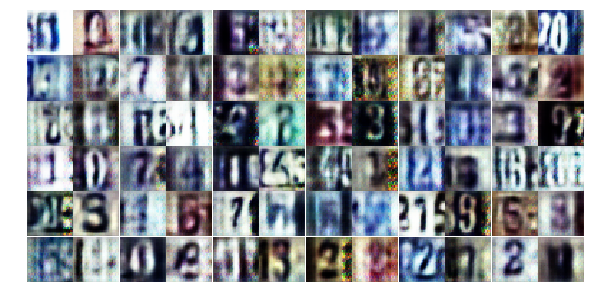

Epoch 14/24... Discriminator Loss: 0.7256... Generator Loss: 1.1222
Epoch 14/24... Discriminator Loss: 0.6515... Generator Loss: 1.1359
Epoch 15/24... Discriminator Loss: 0.6968... Generator Loss: 1.0505
Epoch 15/24... Discriminator Loss: 0.4031... Generator Loss: 1.5824
Epoch 15/24... Discriminator Loss: 0.5031... Generator Loss: 1.1741
Epoch 15/24... Discriminator Loss: 0.5471... Generator Loss: 1.1617
Epoch 15/24... Discriminator Loss: 0.5404... Generator Loss: 1.2514
Epoch 15/24... Discriminator Loss: 1.0582... Generator Loss: 0.5811
Epoch 15/24... Discriminator Loss: 1.3259... Generator Loss: 0.4539
Epoch 15/24... Discriminator Loss: 0.4562... Generator Loss: 1.7534


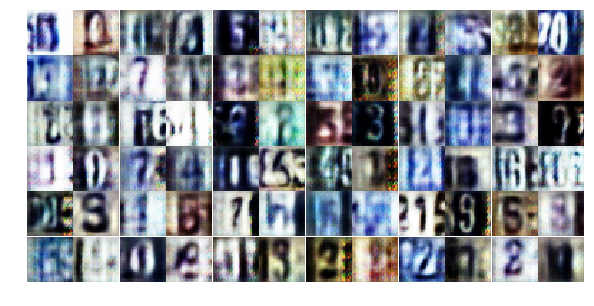

Epoch 15/24... Discriminator Loss: 1.3060... Generator Loss: 0.4634
Epoch 15/24... Discriminator Loss: 0.5763... Generator Loss: 1.3044
Epoch 15/24... Discriminator Loss: 1.0801... Generator Loss: 0.6320
Epoch 15/24... Discriminator Loss: 0.9913... Generator Loss: 0.7209
Epoch 15/24... Discriminator Loss: 0.6005... Generator Loss: 1.2508
Epoch 15/24... Discriminator Loss: 0.5134... Generator Loss: 1.1573
Epoch 15/24... Discriminator Loss: 0.8521... Generator Loss: 0.8170
Epoch 15/24... Discriminator Loss: 0.6677... Generator Loss: 1.0639
Epoch 15/24... Discriminator Loss: 1.2976... Generator Loss: 4.4557
Epoch 15/24... Discriminator Loss: 0.8779... Generator Loss: 0.8644


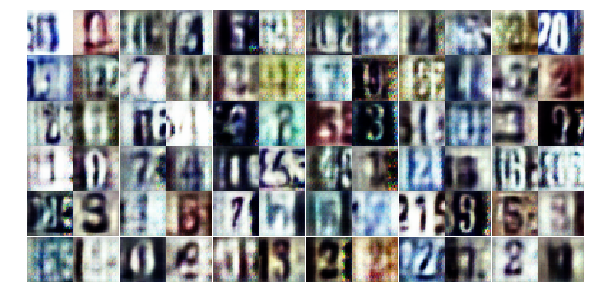

Epoch 15/24... Discriminator Loss: 1.1561... Generator Loss: 0.6080
Epoch 15/24... Discriminator Loss: 0.7301... Generator Loss: 1.0285
Epoch 15/24... Discriminator Loss: 0.5685... Generator Loss: 1.1534
Epoch 15/24... Discriminator Loss: 1.1951... Generator Loss: 0.4959
Epoch 15/24... Discriminator Loss: 1.1250... Generator Loss: 0.6592
Epoch 15/24... Discriminator Loss: 0.5028... Generator Loss: 1.3449
Epoch 15/24... Discriminator Loss: 0.8916... Generator Loss: 0.8281
Epoch 15/24... Discriminator Loss: 1.2547... Generator Loss: 0.4727
Epoch 15/24... Discriminator Loss: 0.7750... Generator Loss: 0.8384
Epoch 15/24... Discriminator Loss: 1.4297... Generator Loss: 0.4741


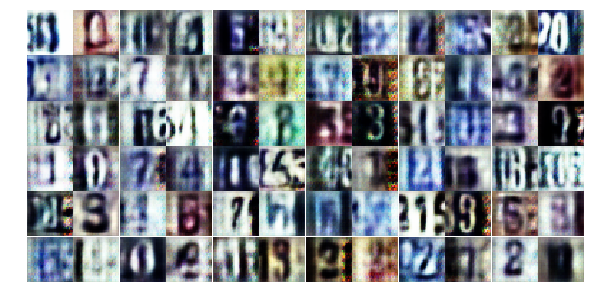

Epoch 15/24... Discriminator Loss: 0.8624... Generator Loss: 0.7563
Epoch 15/24... Discriminator Loss: 0.8468... Generator Loss: 0.8346
Epoch 15/24... Discriminator Loss: 0.6376... Generator Loss: 1.0794
Epoch 15/24... Discriminator Loss: 0.8796... Generator Loss: 0.8095
Epoch 15/24... Discriminator Loss: 0.4693... Generator Loss: 1.2750
Epoch 15/24... Discriminator Loss: 0.7002... Generator Loss: 1.1807
Epoch 15/24... Discriminator Loss: 0.4131... Generator Loss: 1.5401
Epoch 15/24... Discriminator Loss: 0.5459... Generator Loss: 1.3522
Epoch 15/24... Discriminator Loss: 0.2973... Generator Loss: 1.8886
Epoch 15/24... Discriminator Loss: 0.7350... Generator Loss: 0.9773


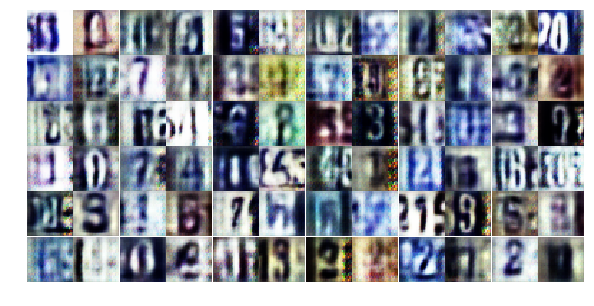

Epoch 15/24... Discriminator Loss: 0.6067... Generator Loss: 1.1752
Epoch 15/24... Discriminator Loss: 1.4126... Generator Loss: 0.4843
Epoch 15/24... Discriminator Loss: 0.7686... Generator Loss: 0.9544
Epoch 15/24... Discriminator Loss: 0.4317... Generator Loss: 1.7320
Epoch 15/24... Discriminator Loss: 0.5249... Generator Loss: 1.6714
Epoch 15/24... Discriminator Loss: 1.5497... Generator Loss: 0.3963
Epoch 15/24... Discriminator Loss: 0.5411... Generator Loss: 1.3521
Epoch 15/24... Discriminator Loss: 0.8458... Generator Loss: 0.9495
Epoch 15/24... Discriminator Loss: 0.8600... Generator Loss: 0.7983
Epoch 15/24... Discriminator Loss: 0.8580... Generator Loss: 0.7868


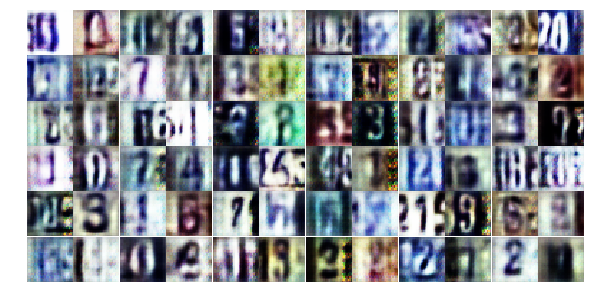

Epoch 15/24... Discriminator Loss: 1.2171... Generator Loss: 0.5800
Epoch 15/24... Discriminator Loss: 0.8454... Generator Loss: 0.8022
Epoch 15/24... Discriminator Loss: 0.6133... Generator Loss: 1.0925
Epoch 15/24... Discriminator Loss: 0.5671... Generator Loss: 1.1558
Epoch 15/24... Discriminator Loss: 0.4245... Generator Loss: 1.5117
Epoch 15/24... Discriminator Loss: 1.1147... Generator Loss: 0.5340
Epoch 15/24... Discriminator Loss: 1.1072... Generator Loss: 0.7642
Epoch 15/24... Discriminator Loss: 0.4443... Generator Loss: 2.0458
Epoch 15/24... Discriminator Loss: 0.9753... Generator Loss: 0.7919
Epoch 16/24... Discriminator Loss: 0.9825... Generator Loss: 2.2692


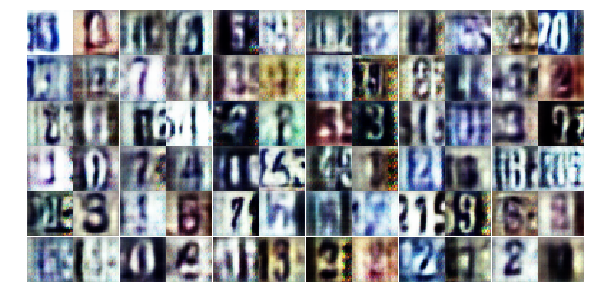

Epoch 16/24... Discriminator Loss: 0.5220... Generator Loss: 1.3516
Epoch 16/24... Discriminator Loss: 0.8189... Generator Loss: 0.8229
Epoch 16/24... Discriminator Loss: 0.9265... Generator Loss: 0.6699
Epoch 16/24... Discriminator Loss: 0.9609... Generator Loss: 0.7913
Epoch 16/24... Discriminator Loss: 0.5954... Generator Loss: 1.2013
Epoch 16/24... Discriminator Loss: 0.7288... Generator Loss: 0.8924
Epoch 16/24... Discriminator Loss: 2.0699... Generator Loss: 0.2634
Epoch 16/24... Discriminator Loss: 0.5960... Generator Loss: 1.2846
Epoch 16/24... Discriminator Loss: 0.8541... Generator Loss: 0.7910
Epoch 16/24... Discriminator Loss: 0.7047... Generator Loss: 1.0632


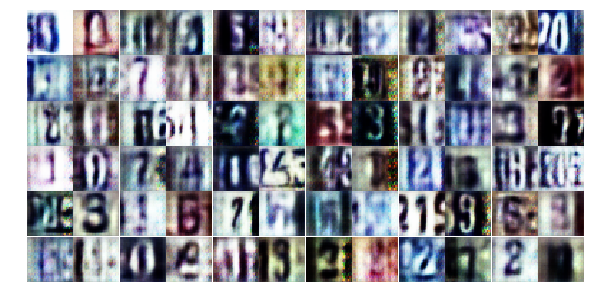

Epoch 16/24... Discriminator Loss: 1.5663... Generator Loss: 0.3764
Epoch 16/24... Discriminator Loss: 0.6848... Generator Loss: 1.0995
Epoch 16/24... Discriminator Loss: 0.7813... Generator Loss: 0.9077
Epoch 16/24... Discriminator Loss: 1.8866... Generator Loss: 0.2418
Epoch 16/24... Discriminator Loss: 0.5564... Generator Loss: 1.9510
Epoch 16/24... Discriminator Loss: 0.5174... Generator Loss: 1.1979
Epoch 16/24... Discriminator Loss: 1.1395... Generator Loss: 0.5834
Epoch 16/24... Discriminator Loss: 0.4553... Generator Loss: 1.3778
Epoch 16/24... Discriminator Loss: 0.5511... Generator Loss: 1.2046
Epoch 16/24... Discriminator Loss: 0.7927... Generator Loss: 0.8764


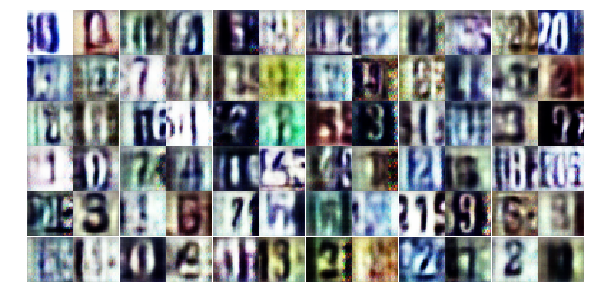

Epoch 16/24... Discriminator Loss: 0.7278... Generator Loss: 0.9678
Epoch 16/24... Discriminator Loss: 0.4645... Generator Loss: 1.3850
Epoch 16/24... Discriminator Loss: 0.7893... Generator Loss: 0.8740
Epoch 16/24... Discriminator Loss: 1.4416... Generator Loss: 0.3990
Epoch 16/24... Discriminator Loss: 0.5110... Generator Loss: 1.4032
Epoch 16/24... Discriminator Loss: 0.7833... Generator Loss: 0.8498
Epoch 16/24... Discriminator Loss: 0.8496... Generator Loss: 0.7894
Epoch 16/24... Discriminator Loss: 0.7788... Generator Loss: 0.8852
Epoch 16/24... Discriminator Loss: 0.9730... Generator Loss: 0.7291
Epoch 16/24... Discriminator Loss: 1.0076... Generator Loss: 0.6555


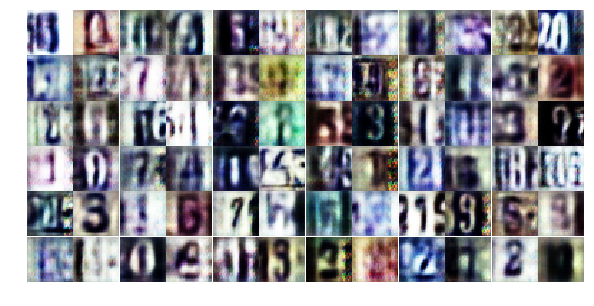

Epoch 16/24... Discriminator Loss: 0.8223... Generator Loss: 0.8515
Epoch 16/24... Discriminator Loss: 0.5003... Generator Loss: 1.4059
Epoch 16/24... Discriminator Loss: 0.3870... Generator Loss: 1.5563
Epoch 16/24... Discriminator Loss: 0.9904... Generator Loss: 0.6212
Epoch 16/24... Discriminator Loss: 1.2191... Generator Loss: 0.4572
Epoch 16/24... Discriminator Loss: 0.6197... Generator Loss: 1.1795
Epoch 16/24... Discriminator Loss: 0.6627... Generator Loss: 1.2287
Epoch 16/24... Discriminator Loss: 0.9514... Generator Loss: 0.7322
Epoch 16/24... Discriminator Loss: 1.1099... Generator Loss: 0.6168
Epoch 16/24... Discriminator Loss: 0.8805... Generator Loss: 0.7700


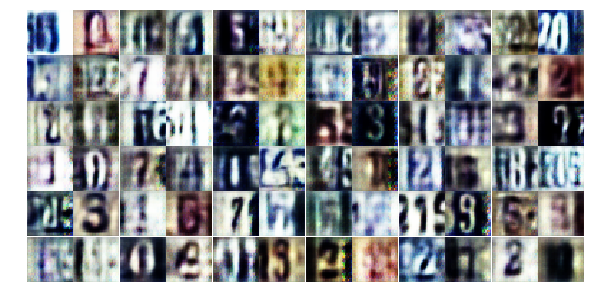

Epoch 16/24... Discriminator Loss: 1.1080... Generator Loss: 0.5715
Epoch 16/24... Discriminator Loss: 1.1831... Generator Loss: 3.3801
Epoch 16/24... Discriminator Loss: 1.4392... Generator Loss: 0.3878
Epoch 16/24... Discriminator Loss: 0.5253... Generator Loss: 1.3852
Epoch 16/24... Discriminator Loss: 1.2425... Generator Loss: 0.5170
Epoch 16/24... Discriminator Loss: 0.8676... Generator Loss: 0.8129
Epoch 16/24... Discriminator Loss: 0.6750... Generator Loss: 2.4050
Epoch 16/24... Discriminator Loss: 0.9743... Generator Loss: 0.7268
Epoch 16/24... Discriminator Loss: 0.7251... Generator Loss: 0.9796
Epoch 16/24... Discriminator Loss: 1.2790... Generator Loss: 0.4347


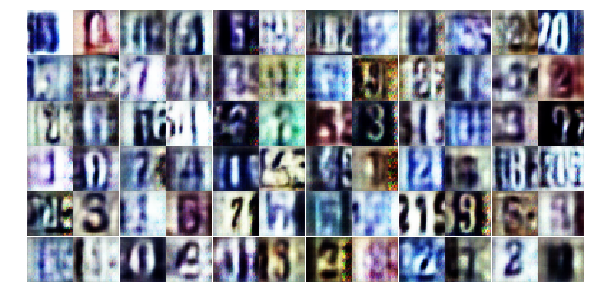

Epoch 16/24... Discriminator Loss: 1.0664... Generator Loss: 0.6577
Epoch 16/24... Discriminator Loss: 1.0201... Generator Loss: 0.6711
Epoch 16/24... Discriminator Loss: 1.4049... Generator Loss: 0.4578
Epoch 16/24... Discriminator Loss: 0.5067... Generator Loss: 1.6137
Epoch 16/24... Discriminator Loss: 0.3551... Generator Loss: 1.8738
Epoch 16/24... Discriminator Loss: 0.5953... Generator Loss: 1.5927
Epoch 17/24... Discriminator Loss: 0.6103... Generator Loss: 1.1609
Epoch 17/24... Discriminator Loss: 1.2531... Generator Loss: 0.5476
Epoch 17/24... Discriminator Loss: 0.6419... Generator Loss: 2.3984
Epoch 17/24... Discriminator Loss: 0.7977... Generator Loss: 1.0250


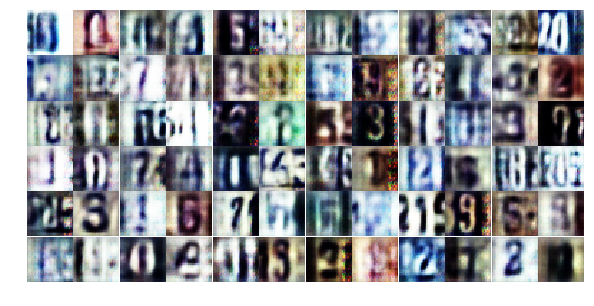

Epoch 17/24... Discriminator Loss: 0.6862... Generator Loss: 1.0987
Epoch 17/24... Discriminator Loss: 0.6450... Generator Loss: 1.0483
Epoch 17/24... Discriminator Loss: 0.8102... Generator Loss: 0.9292
Epoch 17/24... Discriminator Loss: 0.8025... Generator Loss: 0.8495
Epoch 17/24... Discriminator Loss: 0.8499... Generator Loss: 0.8179
Epoch 17/24... Discriminator Loss: 0.6287... Generator Loss: 1.3552
Epoch 17/24... Discriminator Loss: 0.6824... Generator Loss: 1.2049
Epoch 17/24... Discriminator Loss: 1.3732... Generator Loss: 0.4854
Epoch 17/24... Discriminator Loss: 0.6355... Generator Loss: 0.9951
Epoch 17/24... Discriminator Loss: 0.5272... Generator Loss: 2.0901


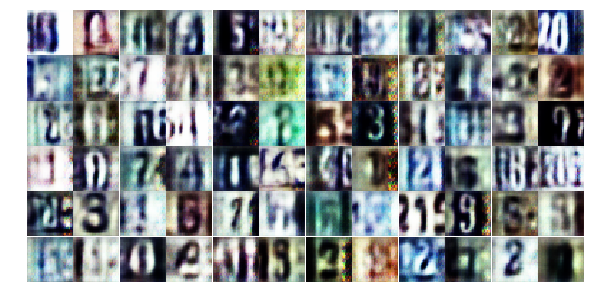

Epoch 17/24... Discriminator Loss: 0.9707... Generator Loss: 0.7570
Epoch 17/24... Discriminator Loss: 1.1122... Generator Loss: 0.6029
Epoch 17/24... Discriminator Loss: 0.7180... Generator Loss: 1.0027
Epoch 17/24... Discriminator Loss: 0.5962... Generator Loss: 1.3536
Epoch 17/24... Discriminator Loss: 0.4908... Generator Loss: 1.2621
Epoch 17/24... Discriminator Loss: 1.1747... Generator Loss: 0.5400
Epoch 17/24... Discriminator Loss: 0.6325... Generator Loss: 1.3311
Epoch 17/24... Discriminator Loss: 0.6321... Generator Loss: 1.0286
Epoch 17/24... Discriminator Loss: 0.6588... Generator Loss: 1.0482
Epoch 17/24... Discriminator Loss: 0.4052... Generator Loss: 1.5057


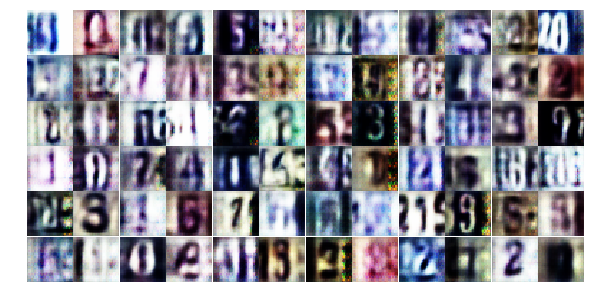

Epoch 17/24... Discriminator Loss: 1.6126... Generator Loss: 0.3341
Epoch 17/24... Discriminator Loss: 0.5907... Generator Loss: 1.4329
Epoch 17/24... Discriminator Loss: 0.6463... Generator Loss: 1.0765
Epoch 17/24... Discriminator Loss: 1.1931... Generator Loss: 0.5213
Epoch 17/24... Discriminator Loss: 1.8472... Generator Loss: 0.2670
Epoch 17/24... Discriminator Loss: 0.5700... Generator Loss: 1.2563
Epoch 17/24... Discriminator Loss: 0.5086... Generator Loss: 1.4082
Epoch 17/24... Discriminator Loss: 1.4071... Generator Loss: 0.4486
Epoch 17/24... Discriminator Loss: 1.2427... Generator Loss: 0.5121
Epoch 17/24... Discriminator Loss: 0.3202... Generator Loss: 2.0042


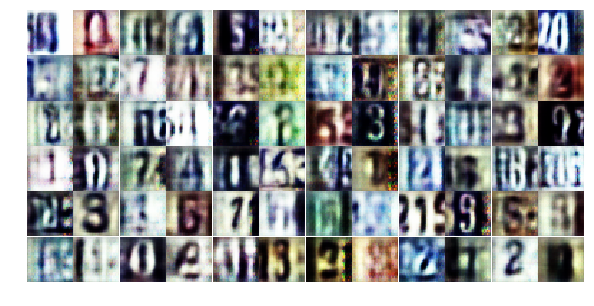

Epoch 17/24... Discriminator Loss: 0.6651... Generator Loss: 2.0484
Epoch 17/24... Discriminator Loss: 1.2501... Generator Loss: 0.5547
Epoch 17/24... Discriminator Loss: 0.7314... Generator Loss: 1.2367
Epoch 17/24... Discriminator Loss: 0.7226... Generator Loss: 1.2867
Epoch 17/24... Discriminator Loss: 1.1601... Generator Loss: 0.5615
Epoch 17/24... Discriminator Loss: 0.9812... Generator Loss: 0.7202
Epoch 17/24... Discriminator Loss: 0.8839... Generator Loss: 0.7212
Epoch 17/24... Discriminator Loss: 0.4792... Generator Loss: 1.3650
Epoch 17/24... Discriminator Loss: 0.2996... Generator Loss: 2.3339
Epoch 17/24... Discriminator Loss: 0.9733... Generator Loss: 0.6389


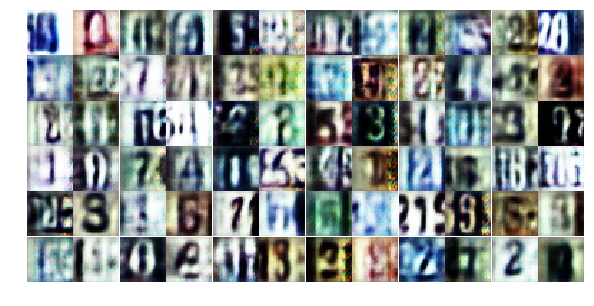

Epoch 17/24... Discriminator Loss: 1.1978... Generator Loss: 0.5222
Epoch 17/24... Discriminator Loss: 0.3620... Generator Loss: 1.7587
Epoch 17/24... Discriminator Loss: 0.7218... Generator Loss: 1.0347
Epoch 17/24... Discriminator Loss: 0.2395... Generator Loss: 2.3464
Epoch 17/24... Discriminator Loss: 0.9881... Generator Loss: 0.8054
Epoch 17/24... Discriminator Loss: 0.7158... Generator Loss: 1.0042
Epoch 17/24... Discriminator Loss: 1.3743... Generator Loss: 0.4403
Epoch 17/24... Discriminator Loss: 0.5727... Generator Loss: 1.2679
Epoch 17/24... Discriminator Loss: 0.4708... Generator Loss: 1.4497
Epoch 17/24... Discriminator Loss: 0.4962... Generator Loss: 1.6010


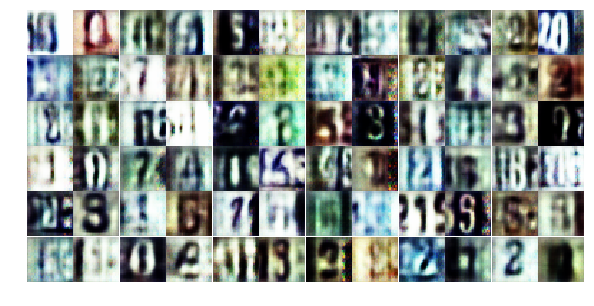

Epoch 17/24... Discriminator Loss: 0.7990... Generator Loss: 1.7852
Epoch 17/24... Discriminator Loss: 0.8002... Generator Loss: 1.0926
Epoch 17/24... Discriminator Loss: 0.3909... Generator Loss: 1.5710
Epoch 17/24... Discriminator Loss: 0.9360... Generator Loss: 0.7589
Epoch 18/24... Discriminator Loss: 0.6570... Generator Loss: 1.1985
Epoch 18/24... Discriminator Loss: 0.9072... Generator Loss: 0.6713
Epoch 18/24... Discriminator Loss: 1.0414... Generator Loss: 0.6921
Epoch 18/24... Discriminator Loss: 0.4993... Generator Loss: 1.3232
Epoch 18/24... Discriminator Loss: 1.3892... Generator Loss: 2.9911
Epoch 18/24... Discriminator Loss: 1.3994... Generator Loss: 2.9468


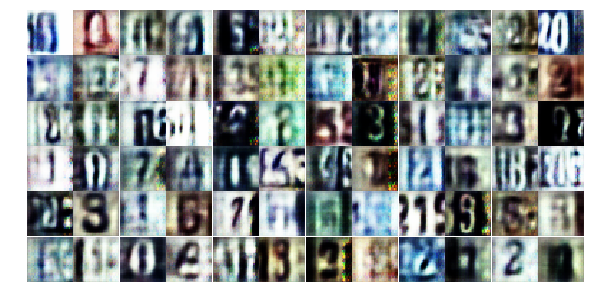

Epoch 18/24... Discriminator Loss: 0.5545... Generator Loss: 1.7146
Epoch 18/24... Discriminator Loss: 1.1986... Generator Loss: 0.5132
Epoch 18/24... Discriminator Loss: 0.8053... Generator Loss: 0.8756
Epoch 18/24... Discriminator Loss: 0.3132... Generator Loss: 1.9396
Epoch 18/24... Discriminator Loss: 0.4270... Generator Loss: 1.5995
Epoch 18/24... Discriminator Loss: 1.5968... Generator Loss: 0.4421
Epoch 18/24... Discriminator Loss: 0.6609... Generator Loss: 1.1975
Epoch 18/24... Discriminator Loss: 0.7858... Generator Loss: 1.1997
Epoch 18/24... Discriminator Loss: 0.6525... Generator Loss: 1.0537
Epoch 18/24... Discriminator Loss: 0.3877... Generator Loss: 1.7216


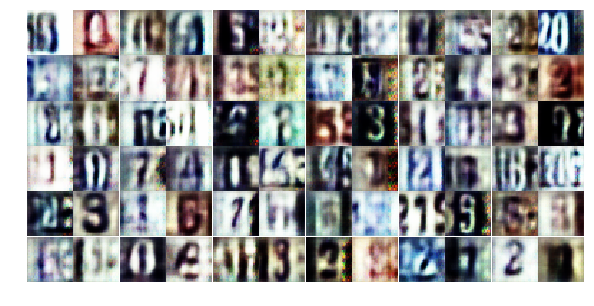

Epoch 18/24... Discriminator Loss: 0.4888... Generator Loss: 1.6281
Epoch 18/24... Discriminator Loss: 0.7808... Generator Loss: 0.8342
Epoch 18/24... Discriminator Loss: 0.7736... Generator Loss: 0.9235
Epoch 18/24... Discriminator Loss: 0.6805... Generator Loss: 1.0475
Epoch 18/24... Discriminator Loss: 0.8842... Generator Loss: 0.7868
Epoch 18/24... Discriminator Loss: 0.8665... Generator Loss: 0.7845
Epoch 18/24... Discriminator Loss: 0.6368... Generator Loss: 1.0723
Epoch 18/24... Discriminator Loss: 0.6613... Generator Loss: 0.9440
Epoch 18/24... Discriminator Loss: 1.0380... Generator Loss: 3.2631
Epoch 18/24... Discriminator Loss: 0.4479... Generator Loss: 1.4731


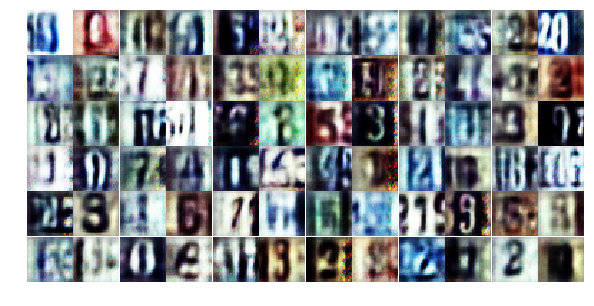

Epoch 18/24... Discriminator Loss: 0.6444... Generator Loss: 1.0777
Epoch 18/24... Discriminator Loss: 0.7132... Generator Loss: 1.1357
Epoch 18/24... Discriminator Loss: 0.9160... Generator Loss: 0.7063
Epoch 18/24... Discriminator Loss: 0.6889... Generator Loss: 0.9857
Epoch 18/24... Discriminator Loss: 1.0409... Generator Loss: 0.6136
Epoch 18/24... Discriminator Loss: 1.1795... Generator Loss: 0.5935
Epoch 18/24... Discriminator Loss: 0.5917... Generator Loss: 1.2424
Epoch 18/24... Discriminator Loss: 0.4016... Generator Loss: 1.9859
Epoch 18/24... Discriminator Loss: 0.5360... Generator Loss: 1.2145
Epoch 18/24... Discriminator Loss: 0.9090... Generator Loss: 0.7935


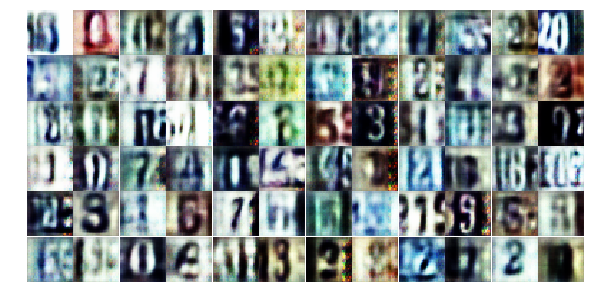

Epoch 18/24... Discriminator Loss: 0.6595... Generator Loss: 1.1708
Epoch 18/24... Discriminator Loss: 1.5453... Generator Loss: 0.3600
Epoch 18/24... Discriminator Loss: 0.6534... Generator Loss: 0.9502
Epoch 18/24... Discriminator Loss: 0.9203... Generator Loss: 0.6814
Epoch 18/24... Discriminator Loss: 1.0830... Generator Loss: 0.6285
Epoch 18/24... Discriminator Loss: 0.4522... Generator Loss: 1.3607
Epoch 18/24... Discriminator Loss: 1.0884... Generator Loss: 0.6401
Epoch 18/24... Discriminator Loss: 0.7572... Generator Loss: 1.8464
Epoch 18/24... Discriminator Loss: 0.8847... Generator Loss: 0.8423
Epoch 18/24... Discriminator Loss: 0.2647... Generator Loss: 2.0820


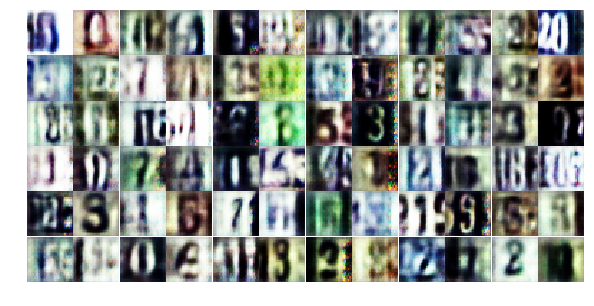

Epoch 18/24... Discriminator Loss: 0.7358... Generator Loss: 0.9126
Epoch 18/24... Discriminator Loss: 0.7616... Generator Loss: 0.9282
Epoch 18/24... Discriminator Loss: 0.7712... Generator Loss: 1.0405
Epoch 18/24... Discriminator Loss: 0.8415... Generator Loss: 0.8397
Epoch 18/24... Discriminator Loss: 1.8126... Generator Loss: 0.2719
Epoch 18/24... Discriminator Loss: 0.5571... Generator Loss: 1.6985
Epoch 18/24... Discriminator Loss: 0.7547... Generator Loss: 0.8980
Epoch 18/24... Discriminator Loss: 0.4156... Generator Loss: 1.5590
Epoch 18/24... Discriminator Loss: 0.8132... Generator Loss: 1.0212
Epoch 18/24... Discriminator Loss: 0.8971... Generator Loss: 0.7509


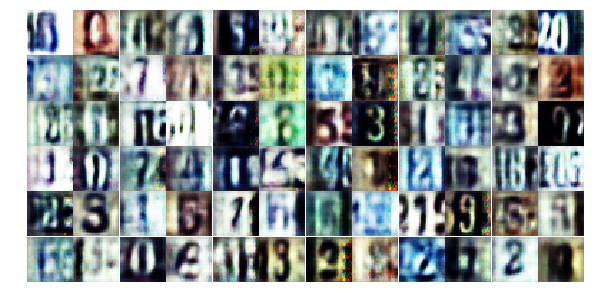

Epoch 18/24... Discriminator Loss: 0.5621... Generator Loss: 1.3810
Epoch 19/24... Discriminator Loss: 1.5389... Generator Loss: 0.3411
Epoch 19/24... Discriminator Loss: 1.2531... Generator Loss: 0.5225
Epoch 19/24... Discriminator Loss: 0.7042... Generator Loss: 0.9541
Epoch 19/24... Discriminator Loss: 0.4532... Generator Loss: 1.3906
Epoch 19/24... Discriminator Loss: 1.2583... Generator Loss: 0.4896
Epoch 19/24... Discriminator Loss: 0.4184... Generator Loss: 1.7130
Epoch 19/24... Discriminator Loss: 0.6681... Generator Loss: 1.1302
Epoch 19/24... Discriminator Loss: 0.6505... Generator Loss: 2.5044
Epoch 19/24... Discriminator Loss: 0.8059... Generator Loss: 1.2650


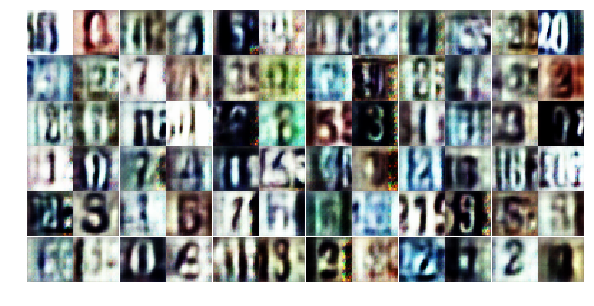

Epoch 19/24... Discriminator Loss: 0.8259... Generator Loss: 0.7663
Epoch 19/24... Discriminator Loss: 0.7305... Generator Loss: 0.9535
Epoch 19/24... Discriminator Loss: 0.9579... Generator Loss: 0.7454
Epoch 19/24... Discriminator Loss: 1.1562... Generator Loss: 0.5519
Epoch 19/24... Discriminator Loss: 0.8642... Generator Loss: 0.8057
Epoch 19/24... Discriminator Loss: 0.8570... Generator Loss: 0.7712
Epoch 19/24... Discriminator Loss: 0.6323... Generator Loss: 1.3736
Epoch 19/24... Discriminator Loss: 1.1468... Generator Loss: 0.5550
Epoch 19/24... Discriminator Loss: 0.9707... Generator Loss: 0.8181
Epoch 19/24... Discriminator Loss: 2.0725... Generator Loss: 0.2268


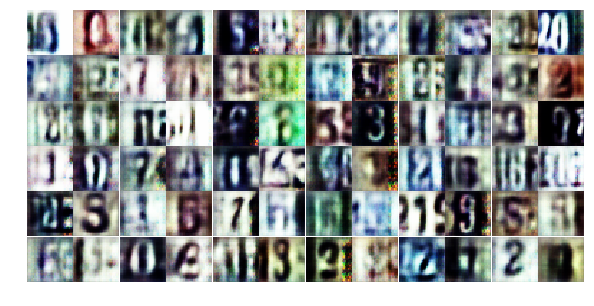

Epoch 19/24... Discriminator Loss: 1.5068... Generator Loss: 0.4131
Epoch 19/24... Discriminator Loss: 0.9725... Generator Loss: 0.7233
Epoch 19/24... Discriminator Loss: 1.4589... Generator Loss: 0.4495
Epoch 19/24... Discriminator Loss: 0.7976... Generator Loss: 0.9549
Epoch 19/24... Discriminator Loss: 1.1093... Generator Loss: 0.6197
Epoch 19/24... Discriminator Loss: 0.9115... Generator Loss: 0.8010
Epoch 19/24... Discriminator Loss: 0.9028... Generator Loss: 0.7738
Epoch 19/24... Discriminator Loss: 0.8488... Generator Loss: 0.8299
Epoch 19/24... Discriminator Loss: 0.9311... Generator Loss: 0.7321
Epoch 19/24... Discriminator Loss: 2.0467... Generator Loss: 0.2797


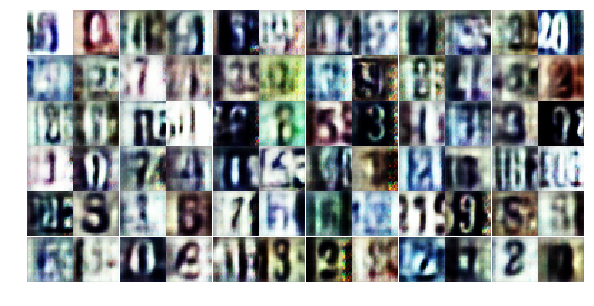

Epoch 19/24... Discriminator Loss: 2.6545... Generator Loss: 5.2098
Epoch 19/24... Discriminator Loss: 0.5435... Generator Loss: 3.0285
Epoch 19/24... Discriminator Loss: 1.1483... Generator Loss: 0.5969
Epoch 19/24... Discriminator Loss: 0.6155... Generator Loss: 1.2531
Epoch 19/24... Discriminator Loss: 0.7647... Generator Loss: 0.9760
Epoch 19/24... Discriminator Loss: 1.3930... Generator Loss: 0.3724
Epoch 19/24... Discriminator Loss: 0.7088... Generator Loss: 1.5103
Epoch 19/24... Discriminator Loss: 0.4033... Generator Loss: 1.6206
Epoch 19/24... Discriminator Loss: 0.6859... Generator Loss: 1.1764
Epoch 19/24... Discriminator Loss: 0.6356... Generator Loss: 0.9939


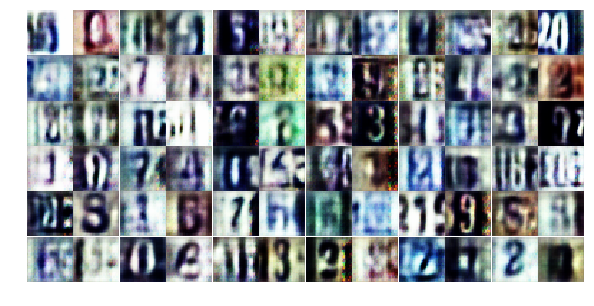

Epoch 19/24... Discriminator Loss: 0.5349... Generator Loss: 1.1311
Epoch 19/24... Discriminator Loss: 0.8294... Generator Loss: 0.8271
Epoch 19/24... Discriminator Loss: 1.3880... Generator Loss: 0.4487
Epoch 19/24... Discriminator Loss: 0.3782... Generator Loss: 1.7906
Epoch 19/24... Discriminator Loss: 0.5960... Generator Loss: 1.3990
Epoch 19/24... Discriminator Loss: 1.0158... Generator Loss: 0.6684
Epoch 19/24... Discriminator Loss: 0.4546... Generator Loss: 1.3853
Epoch 19/24... Discriminator Loss: 0.7305... Generator Loss: 1.0174
Epoch 19/24... Discriminator Loss: 0.5748... Generator Loss: 1.3155
Epoch 19/24... Discriminator Loss: 1.0506... Generator Loss: 0.6460


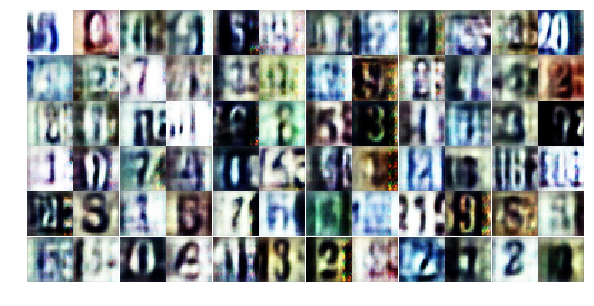

Epoch 19/24... Discriminator Loss: 0.7055... Generator Loss: 0.9715
Epoch 19/24... Discriminator Loss: 1.1855... Generator Loss: 1.0688
Epoch 19/24... Discriminator Loss: 0.7358... Generator Loss: 0.9802
Epoch 19/24... Discriminator Loss: 1.3610... Generator Loss: 0.4247
Epoch 19/24... Discriminator Loss: 0.8361... Generator Loss: 0.7938
Epoch 19/24... Discriminator Loss: 0.6355... Generator Loss: 1.3758
Epoch 19/24... Discriminator Loss: 1.9541... Generator Loss: 0.2330
Epoch 19/24... Discriminator Loss: 0.5996... Generator Loss: 1.3405
Epoch 20/24... Discriminator Loss: 1.0339... Generator Loss: 0.6774
Epoch 20/24... Discriminator Loss: 0.6934... Generator Loss: 1.0361


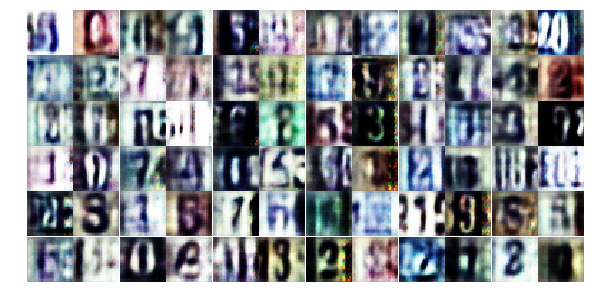

Epoch 20/24... Discriminator Loss: 0.4957... Generator Loss: 1.3344
Epoch 20/24... Discriminator Loss: 1.1343... Generator Loss: 0.6391
Epoch 20/24... Discriminator Loss: 1.3616... Generator Loss: 0.4558
Epoch 20/24... Discriminator Loss: 0.9372... Generator Loss: 0.8416
Epoch 20/24... Discriminator Loss: 0.6463... Generator Loss: 1.1408
Epoch 20/24... Discriminator Loss: 1.3060... Generator Loss: 0.4424
Epoch 20/24... Discriminator Loss: 1.0486... Generator Loss: 0.5856
Epoch 20/24... Discriminator Loss: 0.9031... Generator Loss: 0.7517
Epoch 20/24... Discriminator Loss: 0.8429... Generator Loss: 0.8107
Epoch 20/24... Discriminator Loss: 0.5744... Generator Loss: 1.1875


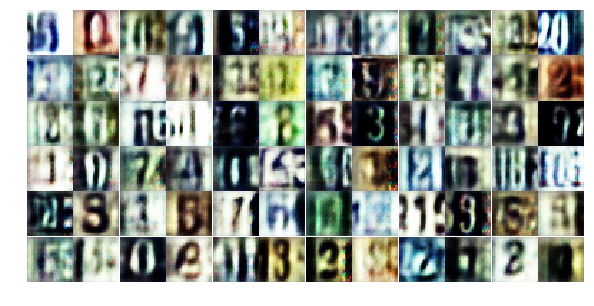

Epoch 20/24... Discriminator Loss: 0.7650... Generator Loss: 0.9185
Epoch 20/24... Discriminator Loss: 0.7659... Generator Loss: 0.9660
Epoch 20/24... Discriminator Loss: 0.7261... Generator Loss: 0.9167
Epoch 20/24... Discriminator Loss: 1.1324... Generator Loss: 0.5724
Epoch 20/24... Discriminator Loss: 1.7302... Generator Loss: 0.3268
Epoch 20/24... Discriminator Loss: 1.4788... Generator Loss: 2.5356
Epoch 20/24... Discriminator Loss: 1.2310... Generator Loss: 0.5884
Epoch 20/24... Discriminator Loss: 0.6492... Generator Loss: 1.1327
Epoch 20/24... Discriminator Loss: 0.7873... Generator Loss: 1.0059
Epoch 20/24... Discriminator Loss: 0.8660... Generator Loss: 0.8709


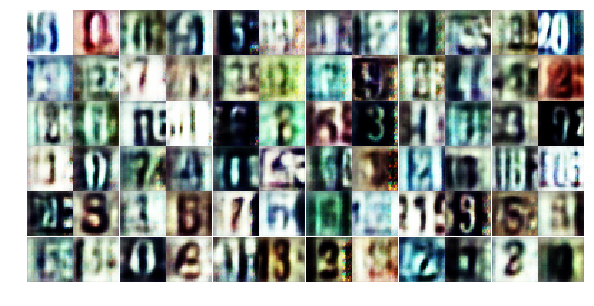

Epoch 20/24... Discriminator Loss: 0.5503... Generator Loss: 1.7682
Epoch 20/24... Discriminator Loss: 0.8689... Generator Loss: 0.8783
Epoch 20/24... Discriminator Loss: 0.3499... Generator Loss: 1.7073
Epoch 20/24... Discriminator Loss: 1.4981... Generator Loss: 0.4146
Epoch 20/24... Discriminator Loss: 0.7064... Generator Loss: 1.2131
Epoch 20/24... Discriminator Loss: 0.6128... Generator Loss: 1.3154
Epoch 20/24... Discriminator Loss: 0.7491... Generator Loss: 2.1107
Epoch 20/24... Discriminator Loss: 1.7505... Generator Loss: 0.2614
Epoch 20/24... Discriminator Loss: 1.1850... Generator Loss: 0.5448
Epoch 20/24... Discriminator Loss: 0.4923... Generator Loss: 1.3400


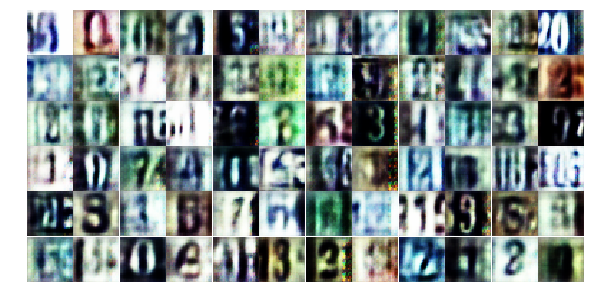

Epoch 20/24... Discriminator Loss: 0.5349... Generator Loss: 1.2173
Epoch 20/24... Discriminator Loss: 0.4694... Generator Loss: 1.3561
Epoch 20/24... Discriminator Loss: 0.8446... Generator Loss: 0.8686
Epoch 20/24... Discriminator Loss: 1.0084... Generator Loss: 0.7182
Epoch 20/24... Discriminator Loss: 0.7016... Generator Loss: 1.1057
Epoch 20/24... Discriminator Loss: 0.8374... Generator Loss: 0.7956
Epoch 20/24... Discriminator Loss: 0.7474... Generator Loss: 1.9217
Epoch 20/24... Discriminator Loss: 0.7448... Generator Loss: 1.0170
Epoch 20/24... Discriminator Loss: 0.6436... Generator Loss: 1.1348
Epoch 20/24... Discriminator Loss: 1.6792... Generator Loss: 0.4080


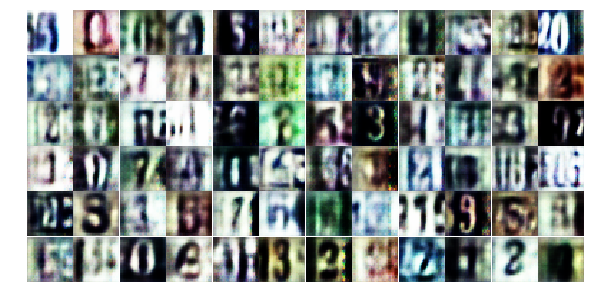

Epoch 20/24... Discriminator Loss: 1.2046... Generator Loss: 0.5669
Epoch 20/24... Discriminator Loss: 0.7552... Generator Loss: 2.4729
Epoch 20/24... Discriminator Loss: 0.5075... Generator Loss: 2.2125
Epoch 20/24... Discriminator Loss: 0.3808... Generator Loss: 1.6836
Epoch 20/24... Discriminator Loss: 0.7703... Generator Loss: 0.9590
Epoch 20/24... Discriminator Loss: 0.9105... Generator Loss: 0.8323
Epoch 20/24... Discriminator Loss: 0.7848... Generator Loss: 0.9500
Epoch 20/24... Discriminator Loss: 0.3639... Generator Loss: 1.8712
Epoch 20/24... Discriminator Loss: 0.7588... Generator Loss: 2.0969
Epoch 20/24... Discriminator Loss: 0.9973... Generator Loss: 0.7021


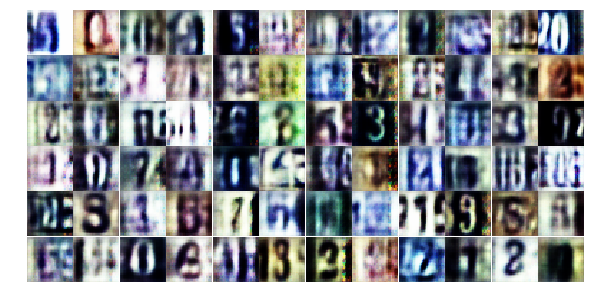

Epoch 20/24... Discriminator Loss: 0.8691... Generator Loss: 0.8099
Epoch 20/24... Discriminator Loss: 0.6166... Generator Loss: 1.2883
Epoch 20/24... Discriminator Loss: 0.5476... Generator Loss: 1.3265
Epoch 20/24... Discriminator Loss: 0.7499... Generator Loss: 1.2869
Epoch 20/24... Discriminator Loss: 0.4996... Generator Loss: 1.3371
Epoch 20/24... Discriminator Loss: 0.4593... Generator Loss: 1.5080
Epoch 21/24... Discriminator Loss: 0.9685... Generator Loss: 0.6987
Epoch 21/24... Discriminator Loss: 0.5267... Generator Loss: 1.2820
Epoch 21/24... Discriminator Loss: 0.8493... Generator Loss: 0.8125
Epoch 21/24... Discriminator Loss: 1.1387... Generator Loss: 0.5613


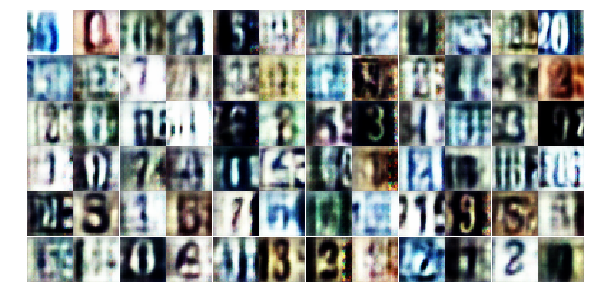

Epoch 21/24... Discriminator Loss: 0.6320... Generator Loss: 1.1826
Epoch 21/24... Discriminator Loss: 1.5524... Generator Loss: 0.4560
Epoch 21/24... Discriminator Loss: 0.6342... Generator Loss: 1.1460
Epoch 21/24... Discriminator Loss: 0.4506... Generator Loss: 1.7260
Epoch 21/24... Discriminator Loss: 1.1166... Generator Loss: 0.6377
Epoch 21/24... Discriminator Loss: 1.1946... Generator Loss: 0.5983
Epoch 21/24... Discriminator Loss: 0.5865... Generator Loss: 1.2145
Epoch 21/24... Discriminator Loss: 0.8422... Generator Loss: 0.8965
Epoch 21/24... Discriminator Loss: 1.1010... Generator Loss: 0.6034
Epoch 21/24... Discriminator Loss: 0.7935... Generator Loss: 0.9756


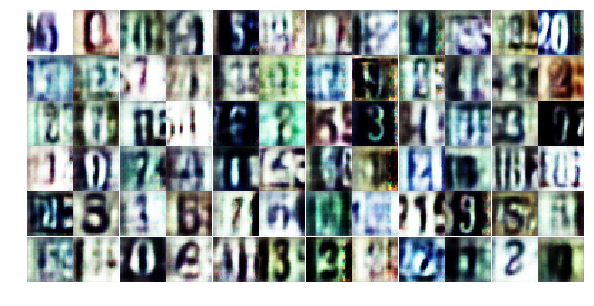

Epoch 21/24... Discriminator Loss: 0.4229... Generator Loss: 1.4978
Epoch 21/24... Discriminator Loss: 0.5519... Generator Loss: 1.4295
Epoch 21/24... Discriminator Loss: 1.3862... Generator Loss: 0.5083
Epoch 21/24... Discriminator Loss: 0.8476... Generator Loss: 0.8501
Epoch 21/24... Discriminator Loss: 0.6303... Generator Loss: 1.3401
Epoch 21/24... Discriminator Loss: 1.0215... Generator Loss: 0.6626
Epoch 21/24... Discriminator Loss: 1.0521... Generator Loss: 0.6831
Epoch 21/24... Discriminator Loss: 0.3724... Generator Loss: 1.8530
Epoch 21/24... Discriminator Loss: 0.6052... Generator Loss: 1.0774
Epoch 21/24... Discriminator Loss: 0.8502... Generator Loss: 0.8006


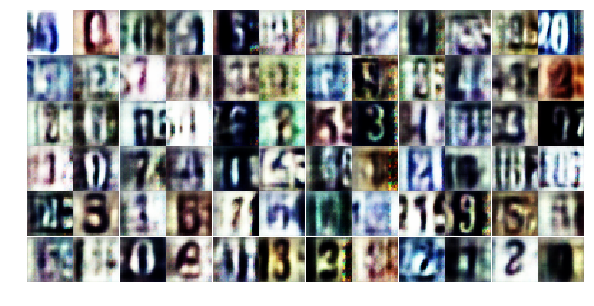

Epoch 21/24... Discriminator Loss: 1.2710... Generator Loss: 0.4954
Epoch 21/24... Discriminator Loss: 0.3780... Generator Loss: 1.5623
Epoch 21/24... Discriminator Loss: 0.6005... Generator Loss: 1.2781
Epoch 21/24... Discriminator Loss: 0.6792... Generator Loss: 1.0242
Epoch 21/24... Discriminator Loss: 1.6739... Generator Loss: 0.2948
Epoch 21/24... Discriminator Loss: 1.3451... Generator Loss: 0.4329
Epoch 21/24... Discriminator Loss: 0.6753... Generator Loss: 3.5903
Epoch 21/24... Discriminator Loss: 0.9873... Generator Loss: 0.8132
Epoch 21/24... Discriminator Loss: 1.2113... Generator Loss: 0.6366
Epoch 21/24... Discriminator Loss: 1.4969... Generator Loss: 0.4637


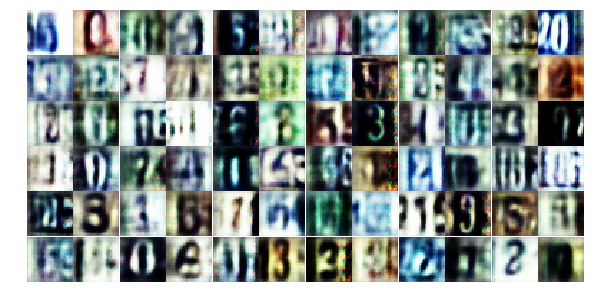

Epoch 21/24... Discriminator Loss: 1.6068... Generator Loss: 0.3800
Epoch 21/24... Discriminator Loss: 0.7292... Generator Loss: 1.0762
Epoch 21/24... Discriminator Loss: 0.6741... Generator Loss: 1.0270
Epoch 21/24... Discriminator Loss: 0.5111... Generator Loss: 1.3145
Epoch 21/24... Discriminator Loss: 0.5806... Generator Loss: 1.2201
Epoch 21/24... Discriminator Loss: 0.7172... Generator Loss: 0.9763
Epoch 21/24... Discriminator Loss: 0.8101... Generator Loss: 0.9109
Epoch 21/24... Discriminator Loss: 1.0144... Generator Loss: 0.7241
Epoch 21/24... Discriminator Loss: 0.4730... Generator Loss: 1.3422
Epoch 21/24... Discriminator Loss: 0.2804... Generator Loss: 2.4610


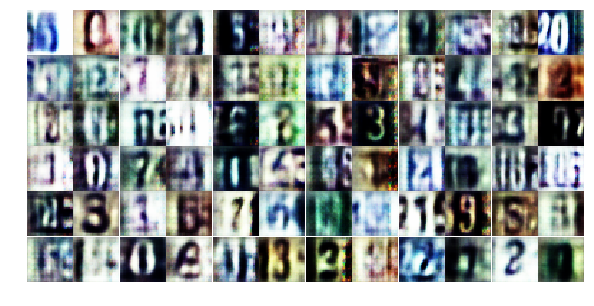

Epoch 21/24... Discriminator Loss: 0.8652... Generator Loss: 1.4262
Epoch 21/24... Discriminator Loss: 0.9984... Generator Loss: 0.8974
Epoch 21/24... Discriminator Loss: 0.8445... Generator Loss: 0.8448
Epoch 21/24... Discriminator Loss: 0.6331... Generator Loss: 1.2708
Epoch 21/24... Discriminator Loss: 0.4387... Generator Loss: 1.3945
Epoch 21/24... Discriminator Loss: 0.6645... Generator Loss: 1.0829
Epoch 21/24... Discriminator Loss: 1.0529... Generator Loss: 0.7021
Epoch 21/24... Discriminator Loss: 1.3299... Generator Loss: 0.4672
Epoch 21/24... Discriminator Loss: 1.1490... Generator Loss: 0.5726
Epoch 21/24... Discriminator Loss: 0.4707... Generator Loss: 1.3147


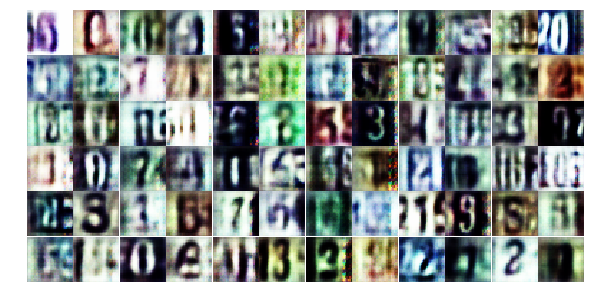

Epoch 21/24... Discriminator Loss: 0.5128... Generator Loss: 1.4406
Epoch 21/24... Discriminator Loss: 1.5867... Generator Loss: 0.3797
Epoch 21/24... Discriminator Loss: 0.8139... Generator Loss: 1.0512
Epoch 22/24... Discriminator Loss: 0.4811... Generator Loss: 1.4081
Epoch 22/24... Discriminator Loss: 0.9039... Generator Loss: 0.7929
Epoch 22/24... Discriminator Loss: 0.8496... Generator Loss: 0.7948
Epoch 22/24... Discriminator Loss: 0.5362... Generator Loss: 1.3315
Epoch 22/24... Discriminator Loss: 0.4188... Generator Loss: 1.5372
Epoch 22/24... Discriminator Loss: 1.7033... Generator Loss: 0.4789
Epoch 22/24... Discriminator Loss: 1.0490... Generator Loss: 0.7521


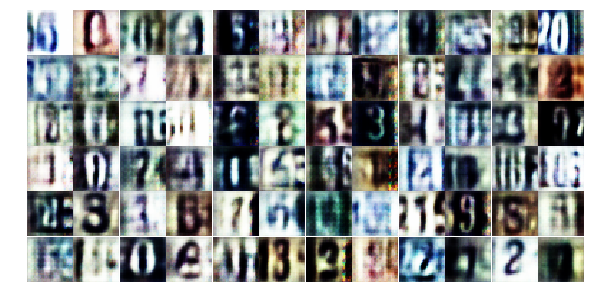

Epoch 22/24... Discriminator Loss: 0.7289... Generator Loss: 1.0998
Epoch 22/24... Discriminator Loss: 1.3784... Generator Loss: 0.5516
Epoch 22/24... Discriminator Loss: 1.3420... Generator Loss: 0.5165
Epoch 22/24... Discriminator Loss: 1.0347... Generator Loss: 0.6485
Epoch 22/24... Discriminator Loss: 0.8426... Generator Loss: 2.8746
Epoch 22/24... Discriminator Loss: 0.7612... Generator Loss: 0.8748
Epoch 22/24... Discriminator Loss: 1.1453... Generator Loss: 0.5421
Epoch 22/24... Discriminator Loss: 0.5634... Generator Loss: 1.2741
Epoch 22/24... Discriminator Loss: 0.9752... Generator Loss: 0.7522
Epoch 22/24... Discriminator Loss: 1.6097... Generator Loss: 0.3983


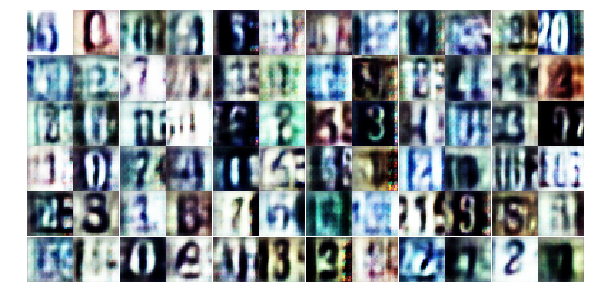

Epoch 22/24... Discriminator Loss: 1.1526... Generator Loss: 0.5733
Epoch 22/24... Discriminator Loss: 0.6123... Generator Loss: 1.1675
Epoch 22/24... Discriminator Loss: 1.0866... Generator Loss: 0.7760
Epoch 22/24... Discriminator Loss: 0.5402... Generator Loss: 1.1832
Epoch 22/24... Discriminator Loss: 0.5060... Generator Loss: 1.6642
Epoch 22/24... Discriminator Loss: 1.3346... Generator Loss: 0.4853
Epoch 22/24... Discriminator Loss: 0.5213... Generator Loss: 1.3027
Epoch 22/24... Discriminator Loss: 0.6569... Generator Loss: 1.0139
Epoch 22/24... Discriminator Loss: 1.0642... Generator Loss: 0.7165
Epoch 22/24... Discriminator Loss: 1.3032... Generator Loss: 0.5074


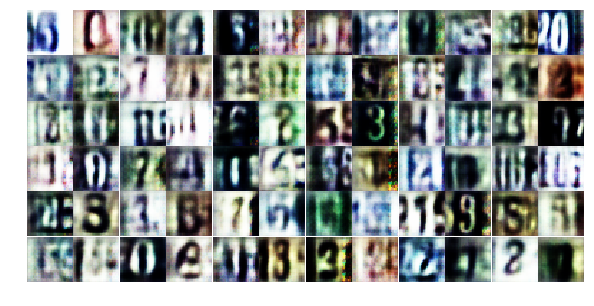

Epoch 22/24... Discriminator Loss: 0.5721... Generator Loss: 1.1591
Epoch 22/24... Discriminator Loss: 0.6801... Generator Loss: 1.0348
Epoch 22/24... Discriminator Loss: 0.7838... Generator Loss: 0.9686
Epoch 22/24... Discriminator Loss: 0.4482... Generator Loss: 1.5141
Epoch 22/24... Discriminator Loss: 0.9217... Generator Loss: 1.1886
Epoch 22/24... Discriminator Loss: 1.1723... Generator Loss: 0.6387
Epoch 22/24... Discriminator Loss: 1.2770... Generator Loss: 0.5154
Epoch 22/24... Discriminator Loss: 0.4863... Generator Loss: 1.8756
Epoch 22/24... Discriminator Loss: 0.8235... Generator Loss: 2.2060
Epoch 22/24... Discriminator Loss: 1.2526... Generator Loss: 0.5395


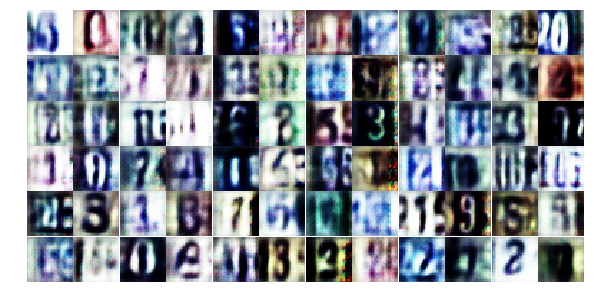

Epoch 22/24... Discriminator Loss: 0.7501... Generator Loss: 1.0405
Epoch 22/24... Discriminator Loss: 0.5314... Generator Loss: 1.1982
Epoch 22/24... Discriminator Loss: 0.8908... Generator Loss: 0.7251
Epoch 22/24... Discriminator Loss: 1.2794... Generator Loss: 0.5495
Epoch 22/24... Discriminator Loss: 0.3901... Generator Loss: 2.0662
Epoch 22/24... Discriminator Loss: 0.4230... Generator Loss: 1.4308
Epoch 22/24... Discriminator Loss: 0.9079... Generator Loss: 0.8973
Epoch 22/24... Discriminator Loss: 0.5067... Generator Loss: 2.3501
Epoch 22/24... Discriminator Loss: 0.8628... Generator Loss: 0.9333
Epoch 22/24... Discriminator Loss: 0.7031... Generator Loss: 1.0583


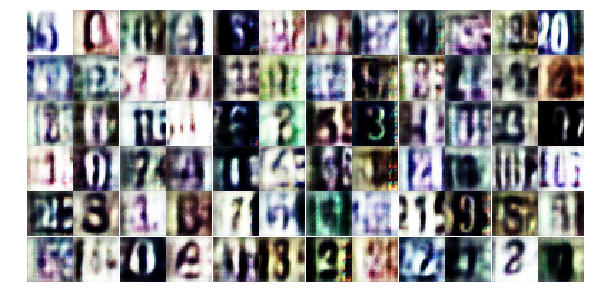

Epoch 22/24... Discriminator Loss: 0.9015... Generator Loss: 0.7813
Epoch 22/24... Discriminator Loss: 0.4833... Generator Loss: 1.4510
Epoch 22/24... Discriminator Loss: 0.5805... Generator Loss: 1.1427
Epoch 22/24... Discriminator Loss: 0.5134... Generator Loss: 1.2710
Epoch 22/24... Discriminator Loss: 1.7158... Generator Loss: 0.3715
Epoch 22/24... Discriminator Loss: 0.4703... Generator Loss: 1.8874
Epoch 22/24... Discriminator Loss: 1.0013... Generator Loss: 1.3119
Epoch 22/24... Discriminator Loss: 0.5339... Generator Loss: 1.2050
Epoch 22/24... Discriminator Loss: 1.0937... Generator Loss: 0.6109
Epoch 22/24... Discriminator Loss: 0.6274... Generator Loss: 1.2296


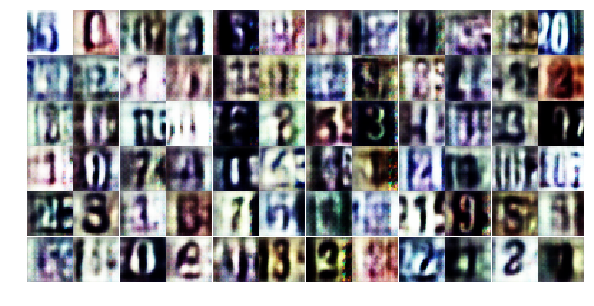

Epoch 23/24... Discriminator Loss: 0.6707... Generator Loss: 1.1952
Epoch 23/24... Discriminator Loss: 0.6408... Generator Loss: 1.1383
Epoch 23/24... Discriminator Loss: 0.9662... Generator Loss: 0.6179
Epoch 23/24... Discriminator Loss: 0.6460... Generator Loss: 1.1170
Epoch 23/24... Discriminator Loss: 0.6250... Generator Loss: 1.1216
Epoch 23/24... Discriminator Loss: 1.6211... Generator Loss: 0.4789
Epoch 23/24... Discriminator Loss: 0.7930... Generator Loss: 0.9130
Epoch 23/24... Discriminator Loss: 0.5754... Generator Loss: 1.1543
Epoch 23/24... Discriminator Loss: 0.9710... Generator Loss: 0.7030
Epoch 23/24... Discriminator Loss: 1.0355... Generator Loss: 0.7223


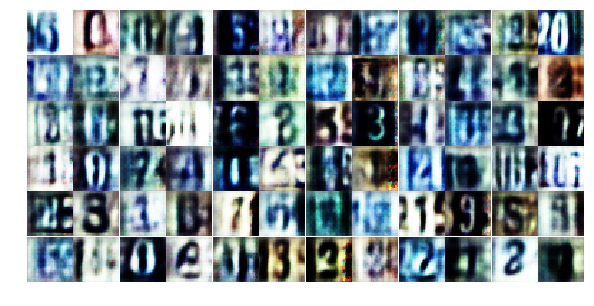

Epoch 23/24... Discriminator Loss: 0.5030... Generator Loss: 1.3289
Epoch 23/24... Discriminator Loss: 0.7976... Generator Loss: 0.8572
Epoch 23/24... Discriminator Loss: 0.9651... Generator Loss: 0.7252
Epoch 23/24... Discriminator Loss: 0.5273... Generator Loss: 1.3084
Epoch 23/24... Discriminator Loss: 0.8566... Generator Loss: 0.8024
Epoch 23/24... Discriminator Loss: 0.9455... Generator Loss: 0.7768
Epoch 23/24... Discriminator Loss: 1.3230... Generator Loss: 0.4628
Epoch 23/24... Discriminator Loss: 1.7385... Generator Loss: 3.5269
Epoch 23/24... Discriminator Loss: 0.9739... Generator Loss: 0.7097
Epoch 23/24... Discriminator Loss: 1.2288... Generator Loss: 0.5216


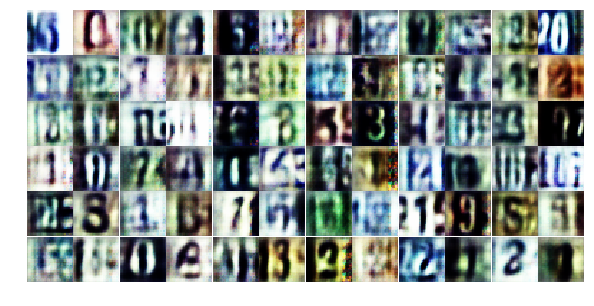

Epoch 23/24... Discriminator Loss: 0.9637... Generator Loss: 0.8071
Epoch 23/24... Discriminator Loss: 0.4905... Generator Loss: 1.6943
Epoch 23/24... Discriminator Loss: 0.5872... Generator Loss: 1.1312
Epoch 23/24... Discriminator Loss: 0.8016... Generator Loss: 0.8402
Epoch 23/24... Discriminator Loss: 0.6821... Generator Loss: 1.1843
Epoch 23/24... Discriminator Loss: 1.0511... Generator Loss: 0.6984
Epoch 23/24... Discriminator Loss: 0.7827... Generator Loss: 0.8617
Epoch 23/24... Discriminator Loss: 0.6726... Generator Loss: 0.9960
Epoch 23/24... Discriminator Loss: 0.5123... Generator Loss: 1.3109
Epoch 23/24... Discriminator Loss: 1.4131... Generator Loss: 0.4655


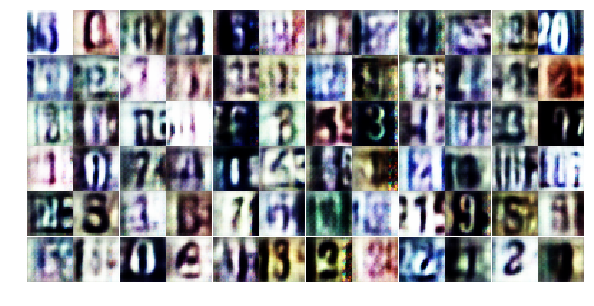

Epoch 23/24... Discriminator Loss: 0.5901... Generator Loss: 1.1281
Epoch 23/24... Discriminator Loss: 1.1256... Generator Loss: 0.5792
Epoch 23/24... Discriminator Loss: 1.1382... Generator Loss: 0.6705
Epoch 23/24... Discriminator Loss: 0.6422... Generator Loss: 1.1084
Epoch 23/24... Discriminator Loss: 1.1333... Generator Loss: 0.6495
Epoch 23/24... Discriminator Loss: 0.7243... Generator Loss: 1.0923
Epoch 23/24... Discriminator Loss: 1.2739... Generator Loss: 0.5144
Epoch 23/24... Discriminator Loss: 0.4840... Generator Loss: 1.4123
Epoch 23/24... Discriminator Loss: 0.6342... Generator Loss: 1.1065
Epoch 23/24... Discriminator Loss: 0.5880... Generator Loss: 1.2137


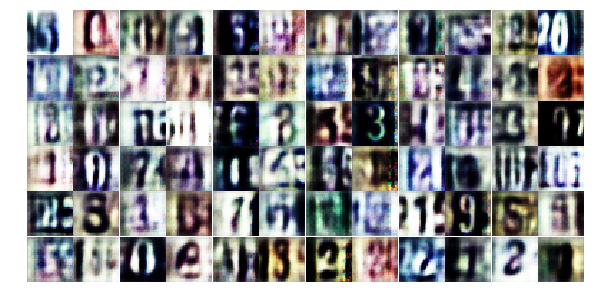

Epoch 23/24... Discriminator Loss: 0.5286... Generator Loss: 1.4016
Epoch 23/24... Discriminator Loss: 0.4496... Generator Loss: 1.3456
Epoch 23/24... Discriminator Loss: 1.0965... Generator Loss: 0.7163
Epoch 23/24... Discriminator Loss: 1.8820... Generator Loss: 0.2362


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))